# How Accessible is Publicly Available Braodband in Los Angeles?
#### Michael Criste |  Fall 2021  |  Midterm

## Project Proposal
revisit initial [proposal here](https://github.com/cristemc/project_proposal) and update to reflect current ideas and deliverables.

How accessible is publicly available broadband access? Federal, state, and local governemnts leverage billions of dollars and partnerships with private-industry partners to make broadband more accessible and increase adoption rates at home. These programs often fund publicly accessible broadband through public schools and libraries to aid children and their families to get online in an effort to increase educational outcomes leading to more economic opportunities. A primary example is the FCC's E-RATE universal services program, which provides funds for obtaining and implementing broadband in school and libraries across urban and rural disctricts. In addition to these access points, private businesses often provide free wifi to customers. Dispite the many access points, challenges still exist: including hours of operation, transportation, location (and weather exposure), device availability, and purchase requirements.

### Why it Matters

As our society has moved online, we have begun the process of reproducing the current systems of inequality into the digital dimension. This is demonstrated by current broadband adoption rates and academic performance seen across income levels and racial groups. Some may suggest that the solution is as simple as giving every student a wifi-enabled laptop, but this far from a solution to a problem that exists within an interconnected ecosystem of hurdles built on current trends of oppression. In most surveys regarding broadband access, respondents often cite the high cost of fixed broadband access as the top deterrent. In addition to the monthly cost of service, there are additional fees and taxes and cost of devices (including computers, routers, etc.). In an article from the Washington Center for Equitable Growth found that 31.4 percent of household with an annual income lower than $50,000 with school-aged children lacked broadband access in their homes. Furthermore, regardless of income levels Black and Latinx children disproportionately lack access when compared to white and Asian children (Crampton, 2018). This creates a homework gap between those who have access at home to support their studies, and those who do not (Yankelevich et al., 2017). Considering that 94 percent of all school districts serving low-income students report assigning internet-based homeowrk (Shapiro, 2015), the need for broadband becomes alarming clear.

### Spatial Scope

Census tracts within the City of Los Angeles

### Data Sources

2019 American Community Survey from Census Reporter and LA City Open Data

### Goals and Intentions 

After first identifying communities with an outstanding percentage of residents who completely lack internet access and those with limited access, I will then map the public access points in relation to these communtiies to assess the proximity and quality of resources through distance, available services (available computers, hotspot loan program, etc.), and populations served.

## Data Exploration
The first portion of this exploration will focus on the cleaning and formatting the data. *expand further*

In [1]:
# IMPORT

#for data processing
import pandas as pd
import numpy as np
import libpysal as lps

#for spatial data
import geopandas as gpd
import esda
from esda.moran import Moran, Moran_Local

#for mapping
import contextily as ctx
import osmnx as ox
import networkx as nx

#for dataviz
import matplotlib.pyplot as plt
import plotly.express as px
import urllib.request, json 
import seaborn as sns

import plotly.graph_objects as go
from plotly.subplots import make_subplots

#for data retrieval
from sodapy import socrata

#For spatial Statics 
import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation
import libpysal as lps

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [2]:
# UPLOAD DATA

#age variable
age = gpd.read_file('data/acs2019_1yr_B28005_16000US0644000.geojson')

#educ varaible
educ = gpd.read_file('data/acs2019_1yr_B28006_16000US0644000.geojson')

#race variable
race = gpd.read_file('data/acs2019_1yr_B28009_all races-b.csv')

#household subscription status
hh = gpd.read_file('data/acs2019_5yr_B28002_14000US06037293306.geojson')

#libraries within LA City 
lib = gpd.read_file('data/LA_Library_Map.csv')

#data from social explorer
se = gpd.read_file('data/R12960103_SL140.csv')

#data from City of LA
tracts = gpd.read_file('data/2010_Census_Tracts_by_Council_District.geojson')
crowd = gpd.read_file('data/Census_Tracts_with_Severely_Overcrowded_Households.geojson')

In [3]:
# api
#lacity_url1 = 'https://services5.arcgis.com/7nsPwEMP38bSkCjy/arcgis/rest/services/Census%20Tracts%202010%20overlaid%20on%20CDs/FeatureServer/0/query?where=1%3D1&outFields=TRACTCE10,POP,TOOLTIP_1,District&geometry=&geometryType=esriGeometryEnvelope&inSR=4326&spatialRel=esriSpatialRelIntersects&outSR=4326&f=json'
#lacity_url2 = 'https://maps.lacity.org/lahub/rest/services/Housing_and_Community_Investment_Department/MapServer/1/query?where=1%3D1&outFields=*&outSR=4326&f=json'

# call the api and bring the data in
#with urllib.request.urlopen(lacity_url1) as url1:
#    data = json.loads(url1.read().decode())

# convert the data to a dataframe
#df = pd.json_normalize(data)
#df


In [4]:
# Understand the data
age.info()
educ.info()
race.info()
hh.info()
lib.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1 entries, 0 to 0
Data columns (total 41 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   geoid             1 non-null      object  
 1   name              1 non-null      object  
 2   B28005001         1 non-null      float64 
 3   B28005001, Error  1 non-null      float64 
 4   B28005002         1 non-null      float64 
 5   B28005002, Error  1 non-null      float64 
 6   B28005003         1 non-null      float64 
 7   B28005003, Error  1 non-null      float64 
 8   B28005004         1 non-null      float64 
 9   B28005004, Error  1 non-null      float64 
 10  B28005005         1 non-null      float64 
 11  B28005005, Error  1 non-null      float64 
 12  B28005006         1 non-null      float64 
 13  B28005006, Error  1 non-null      float64 
 14  B28005007         1 non-null      float64 
 15  B28005007, Error  1 non-null      float64 
 16  B28005008         1 no

In [5]:
#simplify the available data and rename columns for processing. I am going to skip this step for race because I compiled the individual tables from census reporter in excel to save some time.

#age first
age_col2keep = ['geoid',
     'name',
     'B28005001',
     'B28005002',
     'B28005003',
     'B28005004',
     'B28005005',
     'B28005006',
     'B28005007',
     'B28005008',
     'B28005009',
     'B28005010',
     'B28005011',
     'B28005012',
     'B28005013',
     'B28005014',
     'B28005015',
     'B28005016',
     'B28005017',
     'B28005018',
     'B28005019',
     'geometry']
list(age_col2keep)

['geoid',
 'name',
 'B28005001',
 'B28005002',
 'B28005003',
 'B28005004',
 'B28005005',
 'B28005006',
 'B28005007',
 'B28005008',
 'B28005009',
 'B28005010',
 'B28005011',
 'B28005012',
 'B28005013',
 'B28005014',
 'B28005015',
 'B28005016',
 'B28005017',
 'B28005018',
 'B28005019',
 'geometry']

In [6]:
#next, education
educ_col2keep = ['geoid',
     'name',
     'B28006001',
     'B28006002',
     'B28006003',
     'B28006004',
     'B28006005',
     'B28006006',
     'B28006007',
     'B28006008',
     'B28006009',
     'B28006010',
     'B28006011',
     'B28006012',
     'B28006013',
     'B28006014',
     'B28006015',
     'B28006016',
     'B28006017',
     'B28006018',
     'B28006019',
     'geometry']

In [7]:
#same step for houehold data
list(hh)

['geoid',
 'name',
 'B28002001',
 'B28002001, Error',
 'B28002002',
 'B28002002, Error',
 'B28002003',
 'B28002003, Error',
 'B28002004',
 'B28002004, Error',
 'B28002005',
 'B28002005, Error',
 'B28002006',
 'B28002006, Error',
 'B28002007',
 'B28002007, Error',
 'B28002008',
 'B28002008, Error',
 'B28002009',
 'B28002009, Error',
 'B28002010',
 'B28002010, Error',
 'B28002011',
 'B28002011, Error',
 'B28002012',
 'B28002012, Error',
 'B28002013',
 'B28002013, Error',
 'geometry']

In [8]:
hh_col2keep = ['geoid',
 'name',
 'B28002001',
 'B28002002',
 'B28002003',
 'B28002004',
 'B28002005',
 'B28002006',
 'B28002007',
 'B28002008',
 'B28002009',
 'B28002010',
 'B28002011',
 'B28002012',
 'B28002013',
 'geometry']

In [9]:
age = age[age_col2keep]
list(age)

['geoid',
 'name',
 'B28005001',
 'B28005002',
 'B28005003',
 'B28005004',
 'B28005005',
 'B28005006',
 'B28005007',
 'B28005008',
 'B28005009',
 'B28005010',
 'B28005011',
 'B28005012',
 'B28005013',
 'B28005014',
 'B28005015',
 'B28005016',
 'B28005017',
 'B28005018',
 'B28005019',
 'geometry']

In [10]:
educ = educ[educ_col2keep]
list(age)

['geoid',
 'name',
 'B28005001',
 'B28005002',
 'B28005003',
 'B28005004',
 'B28005005',
 'B28005006',
 'B28005007',
 'B28005008',
 'B28005009',
 'B28005010',
 'B28005011',
 'B28005012',
 'B28005013',
 'B28005014',
 'B28005015',
 'B28005016',
 'B28005017',
 'B28005018',
 'B28005019',
 'geometry']

In [11]:
hh = hh[hh_col2keep]
list(hh)

['geoid',
 'name',
 'B28002001',
 'B28002002',
 'B28002003',
 'B28002004',
 'B28002005',
 'B28002006',
 'B28002007',
 'B28002008',
 'B28002009',
 'B28002010',
 'B28002011',
 'B28002012',
 'B28002013',
 'geometry']

In [12]:
age.columns = ['geoid',
 'name',
 'Total',
 'Under 18 years',
 '<18, Has a computer',
 '<18, With dial-up Internet subscription alone',
 '<18, With a broadband Internet subscription',
 '<18, Without an Internet subscription',
 '<18, No computer',
 '18 to 64 years',
 '18-64, Has a computer',
 '18-64, With dial-up Internet subscription alone',
 '18-64, With a broadband Internet subscription',
 '18-64, Without an Internet subscription',
 '18-64, No computer',
 '65 years and over',
 '65, Has a computer',
 '65, With dial-up Internet subscription alone',
 '65, With a broadband Internet subscription',
 '65, Without an Internet subscription',
 '65, No computer',
 'geometry']
age.head()

,geoid,name,Total,Under 18 years,"<18, Has a computer","<18, With dial-up Internet subscription alone","<18, With a broadband Internet subscription","<18, Without an Internet subscription","<18, No computer",18 to 64 years,...,"18-64, With a broadband Internet subscription","18-64, Without an Internet subscription","18-64, No computer",65 years and over,"65, Has a computer","65, With dial-up Internet subscription alone","65, With a broadband Internet subscription","65, Without an Internet subscription","65, No computer",geometry
0,16000US0644000,"Los Angeles, CA",3885625.0,800901.0,788025.0,222.0,745718.0,42085.0,12876.0,2578959.0,...,2378932.0,145935.0,52365.0,505765.0,434466.0,1549.0,388032.0,44885.0,71299.0,"MULTIPOLYGON (((-118.66818 34.18987, -118.6681..."


In [13]:
educ.columns=['geoid',
 'name',
 'Total',
 'Less than high school graduate or equivalency',
 '<HS, Has a computer',
 '<HS, With dial-up Internet subscription alone',
 '<HS, With a broadband Internet subscription',
 '<HS, Without an Internet subscription',
 '<HS, No computer',
 "High school graduate (includes equivalency), some college or associate's degree",
 '>HS, Has a computer',
 '>HS, With dial-up Internet subscription alone',
 '>HS, With a broadband Internet subscription',
 '>HS, Without an Internet subscription',
 '>HS, No computer',
 "Bachelor's degree or higher",
 '>Bach, Has a computer',
 '>Bach, With dial-up Internet subscription alone',
 '>Bach, With a broadband Internet subscription',
 '>Bach, Without an Internet subscription',
 '>Bach, No computer',
 'geometry']
educ.head()

,geoid,name,Total,Less than high school graduate or equivalency,"<HS, Has a computer","<HS, With dial-up Internet subscription alone","<HS, With a broadband Internet subscription","<HS, Without an Internet subscription","<HS, No computer","High school graduate (includes equivalency), some college or associate's degree",...,">HS, With a broadband Internet subscription",">HS, Without an Internet subscription",">HS, No computer",Bachelor's degree or higher,">Bach, Has a computer",">Bach, With dial-up Internet subscription alone",">Bach, With a broadband Internet subscription",">Bach, Without an Internet subscription",">Bach, No computer",geometry
0,16000US0644000,"Los Angeles, CA",2728694.0,584784.0,533424.0,531.0,467300.0,65593.0,51360.0,1154728.0,...,1024262.0,75978.0,52878.0,989182.0,973551.0,905.0,943721.0,28925.0,15631.0,"MULTIPOLYGON (((-118.66818 34.18987, -118.6681..."


In [14]:
hh.columns = ['geoid',
 'name',
 'Total',
 'With an Internet Subscription',
 'Dial-up with no other type of Internet',
 'Broadband of any type',
 'Cellular data plan',
 'Cellular data plan with no other type of Internet subscription',
 'Broadband such as cable, fiber optic or DSL',
 'Broadband such as cable, fiber optic or DSL with no other type of Internet subscription',
 'Satellite Internet service',
 'Satellite Internet service with no other type of Internet subscription',
 'Other service with no other type of Internet subscription',
 'Internet access without a subscription',
 'No Internet access',
 'geometry']
hh.head()

,geoid,name,Total,With an Internet Subscription,Dial-up with no other type of Internet,Broadband of any type,Cellular data plan,Cellular data plan with no other type of Internet subscription,"Broadband such as cable, fiber optic or DSL","Broadband such as cable, fiber optic or DSL with no other type of Internet subscription",Satellite Internet service,Satellite Internet service with no other type of Internet subscription,Other service with no other type of Internet subscription,Internet access without a subscription,No Internet access,geometry
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,1223.0,0.0,1223.0,973.0,97.0,1045.0,218.0,108.0,21.0,0.0,95.0,257.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",1312.0,1095.0,12.0,1083.0,959.0,113.0,960.0,124.0,97.0,0.0,0.0,90.0,127.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",2297.0,1687.0,0.0,1687.0,1453.0,113.0,1388.0,182.0,196.0,33.0,0.0,72.0,538.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",1357.0,1017.0,0.0,1017.0,868.0,142.0,848.0,131.0,44.0,0.0,0.0,59.0,281.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",1445.0,1185.0,18.0,1167.0,955.0,70.0,1080.0,203.0,100.0,0.0,0.0,99.0,161.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


In [15]:
# normalize the data 
age['Percent with a computer under 18 years']=age['<18, Has a computer']/age['Under 18 years']*100
age['Percent with a computer and dial-up internet subscription under 18 years']=age['<18, With dial-up Internet subscription alone']/age['Under 18 years']*100
age['Percent with a computer and broadband internet subscription under 18 years']=age['<18, With a broadband Internet subscription']/age['Under 18 years']*100
age['Percent with a computer and no internet subscription under 18 years']=age['<18, Without an Internet subscription']/age['Under 18 years']*100
age['Percent with no computer under 18 years']=age['<18, No computer']/age['Under 18 years']*100
age['Percent with a computer between 18 and 64 years']=age['<18, Has a computer']/age['18 to 64 years']*100
age['Percent with a computer and dial-up internet subscription between 18 and 64 years']=age['18-64, With dial-up Internet subscription alone']/age['18 to 64 years']*100
age['Percent with a computer and broadband internet subscription between 18 and 64 years']=age['18-64, With a broadband Internet subscription']/age['18 to 64 years']*100
age['Percent with a computer and no internet subscription between 18 and 64 years']=age['18-64, Without an Internet subscription']/age['18 to 64 years']*100
age['Percent with a no computer between 18 and 64']=age['18-64, No computer']/age['18 to 64 years']*100
age['Percent with a computer over 65 years']=age['65, Has a computer']/age['65 years and over']*100
age['Percent with a computer and dial-up internet subscription over 65 years']=age['65, With dial-up Internet subscription alone']/age['65 years and over']*100
age['Percent with a computer and broadband internet subscription over 65 years']=age['65, With a broadband Internet subscription']/age['65 years and over']*100
age['Percent with a computer and no internet subscription over 65 years']=age['65, Without an Internet subscription']/age['65 years and over']*100
age['Percent with a no computer over 65']=age['65, No computer']/age['65 years and over']*100
age.head()

,geoid,name,Total,Under 18 years,"<18, Has a computer","<18, With dial-up Internet subscription alone","<18, With a broadband Internet subscription","<18, Without an Internet subscription","<18, No computer",18 to 64 years,...,Percent with a computer between 18 and 64 years,Percent with a computer and dial-up internet subscription between 18 and 64 years,Percent with a computer and broadband internet subscription between 18 and 64 years,Percent with a computer and no internet subscription between 18 and 64 years,Percent with a no computer between 18 and 64,Percent with a computer over 65 years,Percent with a computer and dial-up internet subscription over 65 years,Percent with a computer and broadband internet subscription over 65 years,Percent with a computer and no internet subscription over 65 years,Percent with a no computer over 65
0,16000US0644000,"Los Angeles, CA",3885625.0,800901.0,788025.0,222.0,745718.0,42085.0,12876.0,2578959.0,...,30.555934,0.066965,92.243886,5.658679,2.03047,85.902741,0.306269,76.721798,8.874675,14.097259


In [16]:
educ['Percent with less than HS and has a computer']=educ['<HS, Has a computer']/educ['Less than high school graduate or equivalency']*100
educ['Percent with less than HS, has a computer with dial-up']=educ['<HS, With dial-up Internet subscription alone']/educ['Less than high school graduate or equivalency']*100
educ['Percent with less than HS, has a computer with broadband']=educ['<HS, With a broadband Internet subscription']/educ['Less than high school graduate or equivalency']*100
educ['Percent with less than HS, has a computer with no internet']=educ['<HS, Without an Internet subscription']/educ['Less than high school graduate or equivalency']*100
educ['Percent with less than HS, has no computer']=educ['<HS, No computer']/educ['Less than high school graduate or equivalency']*100
educ['Percent with more than HS and has a computer']=educ['>HS, Has a computer']/educ["High school graduate (includes equivalency), some college or associate's degree"]*100
educ['Percent with more than HS, has a computer with dial-up']=educ['>HS, With dial-up Internet subscription alone']/educ["High school graduate (includes equivalency), some college or associate's degree"]*100
educ['Percent with more than HS, has a computer with broadband']=educ['>HS, With a broadband Internet subscription']/educ["High school graduate (includes equivalency), some college or associate's degree"]*100
educ['Percent with more than HS, has a computer with no internet']=educ['>HS, Without an Internet subscription']/educ["High school graduate (includes equivalency), some college or associate's degree"]*100
educ['Percent with more than HS, has no computer']=educ['>HS, No computer']/educ["High school graduate (includes equivalency), some college or associate's degree"]*100
educ['Percent with more than Bach and has a computer']=educ['>Bach, Has a computer']/educ["Bachelor's degree or higher"]*100
educ['Percent with more than Bach, has a computer with dial-up']=educ['>Bach, With dial-up Internet subscription alone']/educ["Bachelor's degree or higher"]*100
educ['Percent with more than Bach, has a computer with broadband']=educ['>Bach, With a broadband Internet subscription']/educ["Bachelor's degree or higher"]*100
educ['Percent with more than Bach, has a computer with no internet']=educ['>Bach, Without an Internet subscription']/educ["Bachelor's degree or higher"]*100
educ['Percent with more than Bach, has no computer']=educ['>Bach, No computer']/educ["Bachelor's degree or higher"]*100
educ.head()

,geoid,name,Total,Less than high school graduate or equivalency,"<HS, Has a computer","<HS, With dial-up Internet subscription alone","<HS, With a broadband Internet subscription","<HS, Without an Internet subscription","<HS, No computer","High school graduate (includes equivalency), some college or associate's degree",...,Percent with more than HS and has a computer,"Percent with more than HS, has a computer with dial-up","Percent with more than HS, has a computer with broadband","Percent with more than HS, has a computer with no internet","Percent with more than HS, has no computer",Percent with more than Bach and has a computer,"Percent with more than Bach, has a computer with dial-up","Percent with more than Bach, has a computer with broadband","Percent with more than Bach, has a computer with no internet","Percent with more than Bach, has no computer"
0,16000US0644000,"Los Angeles, CA",2728694.0,584784.0,533424.0,531.0,467300.0,65593.0,51360.0,1154728.0,...,95.42074,0.139427,88.701582,6.579731,4.57926,98.419805,0.09149,95.404182,2.924133,1.580195


In [17]:
#to simplify the normalization process for household subscription status I will only convert those that I need for mapping
hh['Percent with an internet subscription']=hh['With an Internet Subscription']/hh['Total']*100
hh['Percent with a cellular data plan with no other type of Internet']=hh['Cellular data plan with no other type of Internet subscription']/hh['Total']*100
hh['Percent with no internet access']=hh['No Internet access']/hh['Total']*100
hh.head()

,geoid,name,Total,With an Internet Subscription,Dial-up with no other type of Internet,Broadband of any type,Cellular data plan,Cellular data plan with no other type of Internet subscription,"Broadband such as cable, fiber optic or DSL","Broadband such as cable, fiber optic or DSL with no other type of Internet subscription",Satellite Internet service,Satellite Internet service with no other type of Internet subscription,Other service with no other type of Internet subscription,Internet access without a subscription,No Internet access,geometry,Percent with an internet subscription,Percent with a cellular data plan with no other type of Internet,Percent with no internet access
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,1223.0,0.0,1223.0,973.0,97.0,1045.0,218.0,108.0,21.0,0.0,95.0,257.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",77.650794,6.158730,16.317460
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",1312.0,1095.0,12.0,1083.0,959.0,113.0,960.0,124.0,97.0,0.0,0.0,90.0,127.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",83.460366,8.612805,9.679878
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",2297.0,1687.0,0.0,1687.0,1453.0,113.0,1388.0,182.0,196.0,33.0,0.0,72.0,538.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",73.443622,4.919460,23.421855
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",1357.0,1017.0,0.0,1017.0,868.0,142.0,848.0,131.0,44.0,0.0,0.0,59.0,281.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",74.944731,10.464259,20.707443
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",1445.0,1185.0,18.0,1167.0,955.0,70.0,1080.0,203.0,100.0,0.0,0.0,99.0,161.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",82.006920,4.844291,11.141869


In [18]:
#now that that's over I can trim the data even further to prepare to visualize 
age_simp=['Percent with a computer and dial-up internet subscription under 18 years',
       'Percent with a computer and broadband internet subscription under 18 years',
       'Percent with a computer and no internet subscription under 18 years',
       'Percent with no computer under 18 years',
       'Percent with a computer and dial-up internet subscription between 18 and 64 years',
       'Percent with a computer and broadband internet subscription between 18 and 64 years',
       'Percent with a computer and no internet subscription between 18 and 64 years',
       'Percent with a no computer between 18 and 64',
       'Percent with a computer and dial-up internet subscription over 65 years',
       'Percent with a computer and broadband internet subscription over 65 years',
       'Percent with a computer and no internet subscription over 65 years',
       'Percent with a no computer over 65']
age = age[age_simp]

educ_simp=['Percent with less than HS, has a computer with dial-up',
       'Percent with less than HS, has a computer with broadband',
       'Percent with less than HS, has a computer with no internet',
       'Percent with less than HS, has no computer',
       'Percent with more than HS, has a computer with dial-up',
       'Percent with more than HS, has a computer with broadband',
       'Percent with more than HS, has a computer with no internet',
       'Percent with more than HS, has no computer',
       'Percent with more than Bach, has a computer with dial-up',
       'Percent with more than Bach, has a computer with broadband',
       'Percent with more than Bach, has a computer with no internet',
       'Percent with more than Bach, has no computer']
educ = educ[educ_simp]

race_simp = ['race',
             'status',
             'count',]
race = race[race_simp]

#I'm also going to shorten the labels because in the next step I am going added the age ranges as it's own variable
age.columns = ['Percent with a computer and dial-up',
       'Percent with a computer and broadband',
       'Percent with a computer and no internet',
       'Percent with no computer',
       'Percent with a computer and dial-up',
       'Percent with a computer and broadband',
       'Percent with a computer and no internet',
       'Percent with no computer',
       'Percent with a computer and dial-up',
       'Percent with a computer and broadband',
       'Percent with a computer and no internet',
       'Percent with no computer']

educ.columns=['Percent with a computer and dial-up',
       'Percent with a computer and broadband',
       'Percent with a computer and no internet',
       'Percent with no computer',
       'Percent with a computer and dial-up',
       'Percent with a computer and broadband',
       'Percent with a computer and no internet',
       'Percent with no computer',
       'Percent with a computer and dial-up',
       'Percent with a computer and broadband',
       'Percent with a computer and no internet',
       'Percent with no computer']

In [19]:
age=age.T.reset_index().rename(columns={'index':'status',0:'percent'})
educ=educ.T.reset_index().rename(columns={'index':'status',0:'percent'})

In [20]:
age
educ

,status,percent
0,Percent with a computer and dial-up,0.090803
1,Percent with a computer and broadband,79.909847
2,Percent with a computer and no internet,11.216620
3,Percent with no computer,8.782730
4,Percent with a computer and dial-up,0.139427
5,Percent with a computer and broadband,88.701582
6,Percent with a computer and no internet,6.579731
7,Percent with no computer,4.579260
8,Percent with a computer and dial-up,0.091490
9,Percent with a computer and broadband,95.404182


In [21]:
group_col = ['Under 18',
       'Under 18',
       'Under 18',
       'Under 18',
       'Between 18 and 64 years',
       'Between 18 and 64 years',
       'Between 18 and 64 years',
       'Between 18 and 64 years',
       'Over 65 years',
       'Over 65 years',
       'Over 65 years',
       'Over 65 years',]
age.loc[:,'Age Group'] = group_col
age

,status,percent,Age Group
0,Percent with a computer and dial-up,0.027719,Under 18
1,Percent with a computer and broadband,93.109885,Under 18
2,Percent with a computer and no internet,5.254707,Under 18
3,Percent with no computer,1.607689,Under 18
4,Percent with a computer and dial-up,0.066965,Between 18 and 64 years
5,Percent with a computer and broadband,92.243886,Between 18 and 64 years
6,Percent with a computer and no internet,5.658679,Between 18 and 64 years
7,Percent with no computer,2.030470,Between 18 and 64 years
8,Percent with a computer and dial-up,0.306269,Over 65 years
9,Percent with a computer and broadband,76.721798,Over 65 years


In [22]:
educ_lvl = ['Less than high school graduate or equivalency',
            'Less than high school graduate or equivalency',
            'Less than high school graduate or equivalency',
            'Less than high school graduate or equivalency',
            "High school graduate, but less than Bachelor's",
            "High school graduate, but less than Bachelor's",
            "High school graduate, but less than Bachelor's",
            "High school graduate, but less than Bachelor's",
            "Bachelor's degree or higher",
            "Bachelor's degree or higher",
            "Bachelor's degree or higher",
            "Bachelor's degree or higher",]
educ.loc[:,'Educational Attainment'] = educ_lvl
educ

,status,percent,Educational Attainment
0,Percent with a computer and dial-up,0.090803,Less than high school graduate or equivalency
1,Percent with a computer and broadband,79.909847,Less than high school graduate or equivalency
2,Percent with a computer and no internet,11.216620,Less than high school graduate or equivalency
3,Percent with no computer,8.782730,Less than high school graduate or equivalency
4,Percent with a computer and dial-up,0.139427,"High school graduate, but less than Bachelor's"
5,Percent with a computer and broadband,88.701582,"High school graduate, but less than Bachelor's"
6,Percent with a computer and no internet,6.579731,"High school graduate, but less than Bachelor's"
7,Percent with no computer,4.579260,"High school graduate, but less than Bachelor's"
8,Percent with a computer and dial-up,0.091490,Bachelor's degree or higher
9,Percent with a computer and broadband,95.404182,Bachelor's degree or higher


In [23]:
#Now I'll trim the household data for mapping
hh_trim = hh.copy()
hh_trim = ['geoid',
           'name',
           'Total',
           'Percent with an internet subscription',
           'Percent with a cellular data plan with no other type of Internet',
           'Percent with no internet access',
           'geometry']
hh = hh[hh_trim]
hh.tail()

,geoid,name,Total,Percent with an internet subscription,Percent with a cellular data plan with no other type of Internet,Percent with no internet access,geometry
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",4.0,100.000000,0.000000,0.000000,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",0.0,NaN,NaN,NaN,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",24.0,100.000000,0.000000,0.000000,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",0.0,NaN,NaN,NaN,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."
1004,16000US0644000,"Los Angeles, CA",1383869.0,83.290326,9.884823,13.397077,"MULTIPOLYGON (((-118.66818 34.18987, -118.6681..."


In [24]:
#also, I need to remove the totals for the City...which is the last row in the data set
hh=hh.drop([1004])
hh.tail()

,geoid,name,Total,Percent with an internet subscription,Percent with a cellular data plan with no other type of Internet,Percent with no internet access,geometry
999,14000US06037980024,"Census Tract 9800.24, Los Angeles, CA",75.0,94.666667,0.0,5.333333,"MULTIPOLYGON (((-118.51849 34.18389, -118.5184..."
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",4.0,100.000000,0.0,0.000000,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",0.0,NaN,NaN,NaN,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",24.0,100.000000,0.0,0.000000,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",0.0,NaN,NaN,NaN,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."


In [25]:
#Remove non-visible rows
hh.dropna(inplace=True)

In [26]:
# Clean up the library data by seperating the geogrpahic information out of the location column
lib.head()

,Branch Name,Phone Number,Email,Council District,Location,geometry
0,Vermont Square,(323) 290-7405,vmtsqr@lapl.org,9,"1201 W. 48th. Street\nLos Angeles, CA 90037\n(...",None
1,Vernon - Leon H. Washington Jr. Memorial,(323) 234-9106,vrnonl@lapl.org,9,"4504 S. Central Avenue\nLos Angeles, CA 90011\...",None
2,Washington Irving,(323) 734-6303,wirvng@lapl.org,10,"4117 W. Washington Boulevard\nLos Angeles, CA ...",None
3,West Los Angeles Regional,(310) 575-8323,westla@lapl.org,11,"11360 Santa Monica Boulevard\nLos Angeles, CA ...",None
4,West Valley Regional,(818) 345-9806,wvally@lapl.org,3,"19036 Vanowen Street\nReseda, CA 91335\n(34.19...",None


In [27]:
#check to see the datatypes
lib.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 73 entries, 0 to 72
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   Branch Name       73 non-null     object  
 1   Phone Number      73 non-null     object  
 2   Email             73 non-null     object  
 3   Council District  73 non-null     object  
 4   Location          73 non-null     object  
 5   geometry          0 non-null      geometry
dtypes: geometry(1), object(5)
memory usage: 3.5+ KB


In [28]:
#begin the splitting process
lib[['Address','CityZip','LatLon']]=lib.Location.str.split("\n",expand=True)
lib.head()

,Branch Name,Phone Number,Email,Council District,Location,geometry,Address,CityZip,LatLon
0,Vermont Square,(323) 290-7405,vmtsqr@lapl.org,9,"1201 W. 48th. Street\nLos Angeles, CA 90037\n(...",None,1201 W. 48th. Street,"Los Angeles, CA 90037","(33.999699, -118.295799)"
1,Vernon - Leon H. Washington Jr. Memorial,(323) 234-9106,vrnonl@lapl.org,9,"4504 S. Central Avenue\nLos Angeles, CA 90011\...",None,4504 S. Central Avenue,"Los Angeles, CA 90011","(34.002701, -118.256104)"
2,Washington Irving,(323) 734-6303,wirvng@lapl.org,10,"4117 W. Washington Boulevard\nLos Angeles, CA ...",None,4117 W. Washington Boulevard,"Los Angeles, CA 90018","(34.039951, -118.329147)"
3,West Los Angeles Regional,(310) 575-8323,westla@lapl.org,11,"11360 Santa Monica Boulevard\nLos Angeles, CA ...",None,11360 Santa Monica Boulevard,"Los Angeles, CA 90025","(34.0457, -118.450302)"
4,West Valley Regional,(818) 345-9806,wvally@lapl.org,3,"19036 Vanowen Street\nReseda, CA 91335\n(34.19...",None,19036 Vanowen Street,"Reseda, CA 91335","(34.193604, -118.546898)"


In [29]:
lib[['lat','lon']]=lib.LatLon.str.split(",",expand=True)
lib.head()

,Branch Name,Phone Number,Email,Council District,Location,geometry,Address,CityZip,LatLon,lat,lon
0,Vermont Square,(323) 290-7405,vmtsqr@lapl.org,9,"1201 W. 48th. Street\nLos Angeles, CA 90037\n(...",None,1201 W. 48th. Street,"Los Angeles, CA 90037","(33.999699, -118.295799)",(33.999699,-118.295799)
1,Vernon - Leon H. Washington Jr. Memorial,(323) 234-9106,vrnonl@lapl.org,9,"4504 S. Central Avenue\nLos Angeles, CA 90011\...",None,4504 S. Central Avenue,"Los Angeles, CA 90011","(34.002701, -118.256104)",(34.002701,-118.256104)
2,Washington Irving,(323) 734-6303,wirvng@lapl.org,10,"4117 W. Washington Boulevard\nLos Angeles, CA ...",None,4117 W. Washington Boulevard,"Los Angeles, CA 90018","(34.039951, -118.329147)",(34.039951,-118.329147)
3,West Los Angeles Regional,(310) 575-8323,westla@lapl.org,11,"11360 Santa Monica Boulevard\nLos Angeles, CA ...",None,11360 Santa Monica Boulevard,"Los Angeles, CA 90025","(34.0457, -118.450302)",(34.0457,-118.450302)
4,West Valley Regional,(818) 345-9806,wvally@lapl.org,3,"19036 Vanowen Street\nReseda, CA 91335\n(34.19...",None,19036 Vanowen Street,"Reseda, CA 91335","(34.193604, -118.546898)",(34.193604,-118.546898)


In [30]:
#clean uo before further processing
lib_col2keep = ['Branch Name',
                'Phone Number',
                'Email',
                'Address',
                'CityZip',
                'lat',
                'lon']
lib = lib[lib_col2keep]
lib

,Branch Name,Phone Number,Email,Address,CityZip,lat,lon
0,Vermont Square,(323) 290-7405,vmtsqr@lapl.org,1201 W. 48th. Street,"Los Angeles, CA 90037",(33.999699,-118.295799)
1,Vernon - Leon H. Washington Jr. Memorial,(323) 234-9106,vrnonl@lapl.org,4504 S. Central Avenue,"Los Angeles, CA 90011",(34.002701,-118.256104)
2,Washington Irving,(323) 734-6303,wirvng@lapl.org,4117 W. Washington Boulevard,"Los Angeles, CA 90018",(34.039951,-118.329147)
3,West Los Angeles Regional,(310) 575-8323,westla@lapl.org,11360 Santa Monica Boulevard,"Los Angeles, CA 90025",(34.0457,-118.450302)
4,West Valley Regional,(818) 345-9806,wvally@lapl.org,19036 Vanowen Street,"Reseda, CA 91335",(34.193604,-118.546898)
...,...,...,...,...,...,...,...
68,Sunland - Tujunga,(818) 352-4481,snlndt@lapl.org,7771 Foothill Boulevard,"Tujunga, CA 91042",(34.258099,-118.301498)
69,Sylmar,(818) 367-6102,sylmar@lapl.org,14561 Polk Street,"Sylmar, CA 91342",(34.30735,-118.45015)
70,Valley Plaza,(818) 765-9251,valplz@lapl.org,12311 Vanowen Street,"North Hollywood, CA 91605",(34.194302,-118.4011)
71,Van Nuys,(818) 756-8453,vnnuys@lapl.org,6250 Sylmar Ave,"Van Nuys, CA 91401",(34.183899,-118.446297)


In [31]:
#now I must remove the parenthesis in the lat and lon columns to plot them
lib['lat'] = lib['lat'].str[1:]
lib['lon'] = lib['lon'].str[:-1]
lib

,Branch Name,Phone Number,Email,Address,CityZip,lat,lon
0,Vermont Square,(323) 290-7405,vmtsqr@lapl.org,1201 W. 48th. Street,"Los Angeles, CA 90037",33.999699,-118.295799
1,Vernon - Leon H. Washington Jr. Memorial,(323) 234-9106,vrnonl@lapl.org,4504 S. Central Avenue,"Los Angeles, CA 90011",34.002701,-118.256104
2,Washington Irving,(323) 734-6303,wirvng@lapl.org,4117 W. Washington Boulevard,"Los Angeles, CA 90018",34.039951,-118.329147
3,West Los Angeles Regional,(310) 575-8323,westla@lapl.org,11360 Santa Monica Boulevard,"Los Angeles, CA 90025",34.0457,-118.450302
4,West Valley Regional,(818) 345-9806,wvally@lapl.org,19036 Vanowen Street,"Reseda, CA 91335",34.193604,-118.546898
...,...,...,...,...,...,...,...
68,Sunland - Tujunga,(818) 352-4481,snlndt@lapl.org,7771 Foothill Boulevard,"Tujunga, CA 91042",34.258099,-118.301498
69,Sylmar,(818) 367-6102,sylmar@lapl.org,14561 Polk Street,"Sylmar, CA 91342",34.30735,-118.45015
70,Valley Plaza,(818) 765-9251,valplz@lapl.org,12311 Vanowen Street,"North Hollywood, CA 91605",34.194302,-118.4011
71,Van Nuys,(818) 756-8453,vnnuys@lapl.org,6250 Sylmar Ave,"Van Nuys, CA 91401",34.183899,-118.446297


In [32]:
lib.head()

,Branch Name,Phone Number,Email,Address,CityZip,lat,lon
0,Vermont Square,(323) 290-7405,vmtsqr@lapl.org,1201 W. 48th. Street,"Los Angeles, CA 90037",33.999699,-118.295799
1,Vernon - Leon H. Washington Jr. Memorial,(323) 234-9106,vrnonl@lapl.org,4504 S. Central Avenue,"Los Angeles, CA 90011",34.002701,-118.256104
2,Washington Irving,(323) 734-6303,wirvng@lapl.org,4117 W. Washington Boulevard,"Los Angeles, CA 90018",34.039951,-118.329147
3,West Los Angeles Regional,(310) 575-8323,westla@lapl.org,11360 Santa Monica Boulevard,"Los Angeles, CA 90025",34.0457,-118.450302
4,West Valley Regional,(818) 345-9806,wvally@lapl.org,19036 Vanowen Street,"Reseda, CA 91335",34.193604,-118.546898


In [33]:
lib.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73 entries, 0 to 72
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Branch Name   73 non-null     object
 1   Phone Number  73 non-null     object
 2   Email         73 non-null     object
 3   Address       73 non-null     object
 4   CityZip       73 non-null     object
 5   lat           73 non-null     object
 6   lon           73 non-null     object
dtypes: object(7)
memory usage: 4.1+ KB


In [34]:
#I am going to reorder the list alphbetically by Branch Name 
lib.sort_values('Branch Name', ascending = True)
lib

,Branch Name,Phone Number,Email,Address,CityZip,lat,lon
0,Vermont Square,(323) 290-7405,vmtsqr@lapl.org,1201 W. 48th. Street,"Los Angeles, CA 90037",33.999699,-118.295799
1,Vernon - Leon H. Washington Jr. Memorial,(323) 234-9106,vrnonl@lapl.org,4504 S. Central Avenue,"Los Angeles, CA 90011",34.002701,-118.256104
2,Washington Irving,(323) 734-6303,wirvng@lapl.org,4117 W. Washington Boulevard,"Los Angeles, CA 90018",34.039951,-118.329147
3,West Los Angeles Regional,(310) 575-8323,westla@lapl.org,11360 Santa Monica Boulevard,"Los Angeles, CA 90025",34.0457,-118.450302
4,West Valley Regional,(818) 345-9806,wvally@lapl.org,19036 Vanowen Street,"Reseda, CA 91335",34.193604,-118.546898
...,...,...,...,...,...,...,...
68,Sunland - Tujunga,(818) 352-4481,snlndt@lapl.org,7771 Foothill Boulevard,"Tujunga, CA 91042",34.258099,-118.301498
69,Sylmar,(818) 367-6102,sylmar@lapl.org,14561 Polk Street,"Sylmar, CA 91342",34.30735,-118.45015
70,Valley Plaza,(818) 765-9251,valplz@lapl.org,12311 Vanowen Street,"North Hollywood, CA 91605",34.194302,-118.4011
71,Van Nuys,(818) 756-8453,vnnuys@lapl.org,6250 Sylmar Ave,"Van Nuys, CA 91401",34.183899,-118.446297


In [35]:
#Glad that is done, but it is not over yet...Only 18 of the 73 libraries offer wifi hotspot rentals, so I will need to add a column and signify which libraries do
hotspot = ['no',
           'no',
           'yes',
           'no',
           'yes',
           'yes',
           'no',
           'no',
           'no',
           'yes',
           'no',
           'no',
           'no',
           'yes',
           'no',
           'no',
           'no',
           'no',
           'no',
           'no',
           'no',
           'no',
           'no',
           'no',
           'yes',
           'no',
           'yes',
           'yes',
           'no',
           'no',
           'no',
           'yes',
           'no',
           'no',
           'no',
           'yes',
           'no',
           'no',
           'no',
           'no',
           'no',
           'no',
           'no',
           'yes',
           'no',
           'no',
           'no',
           'yes',
           'no',
           'no',
           'yes',
           'no',
           'no',
           'no',
           'no',
           'yes',
           'no',
           'yes',
           'no',
           'no',
           'no',
           'no',
           'no',
           'no',
           'yes',
           'no',
           'no',
           'yes',
           'no',
           'yes',
           'no',
           'no',
           'no']

In [36]:
lib.loc[:,'Hotspot Loan'] = hotspot
lib

,Branch Name,Phone Number,Email,Address,CityZip,lat,lon,Hotspot Loan
0,Vermont Square,(323) 290-7405,vmtsqr@lapl.org,1201 W. 48th. Street,"Los Angeles, CA 90037",33.999699,-118.295799,no
1,Vernon - Leon H. Washington Jr. Memorial,(323) 234-9106,vrnonl@lapl.org,4504 S. Central Avenue,"Los Angeles, CA 90011",34.002701,-118.256104,no
2,Washington Irving,(323) 734-6303,wirvng@lapl.org,4117 W. Washington Boulevard,"Los Angeles, CA 90018",34.039951,-118.329147,yes
3,West Los Angeles Regional,(310) 575-8323,westla@lapl.org,11360 Santa Monica Boulevard,"Los Angeles, CA 90025",34.0457,-118.450302,no
4,West Valley Regional,(818) 345-9806,wvally@lapl.org,19036 Vanowen Street,"Reseda, CA 91335",34.193604,-118.546898,yes
...,...,...,...,...,...,...,...,...
68,Sunland - Tujunga,(818) 352-4481,snlndt@lapl.org,7771 Foothill Boulevard,"Tujunga, CA 91042",34.258099,-118.301498,no
69,Sylmar,(818) 367-6102,sylmar@lapl.org,14561 Polk Street,"Sylmar, CA 91342",34.30735,-118.45015,yes
70,Valley Plaza,(818) 765-9251,valplz@lapl.org,12311 Vanowen Street,"North Hollywood, CA 91605",34.194302,-118.4011,no
71,Van Nuys,(818) 756-8453,vnnuys@lapl.org,6250 Sylmar Ave,"Van Nuys, CA 91401",34.183899,-118.446297,no


In [37]:
# trim city census tract data to prepare for spatial join
tracts.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1310 entries, 0 to 1309
Data columns (total 34 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       1310 non-null   int64   
 1   NAME           1310 non-null   object  
 2   Effective      1310 non-null   int64   
 3   Revised        1310 non-null   int64   
 4   District       1310 non-null   int64   
 5   District_Name  1310 non-null   object  
 6   TOOLTIP        1310 non-null   object  
 7   NLA_URL        1310 non-null   object  
 8   TRACTCE10      1310 non-null   object  
 9   POP            1310 non-null   int64   
 10  LATPOP_D       1310 non-null   int64   
 11  WHIPOP_D       1310 non-null   int64   
 12  BLAPOP_D       1310 non-null   int64   
 13  AMIPOP_D       1310 non-null   int64   
 14  ASIPOP_D       1310 non-null   int64   
 15  HPIPOP_D       1310 non-null   int64   
 16  OTHPOP_D       1310 non-null   int64   
 17  MMRPOP_D       1310 non-n

In [38]:
tracts.sample(10)

,OBJECTID,NAME,Effective,Revised,District,District_Name,TOOLTIP,NLA_URL,TRACTCE10,POP,...,HPIVAP_D,OTHVAP_D,MMRVAP_D,H0010001,H0010002,H0010003,TOOLTIP_1,NLA_URL_1,AnalysisArea,geometry
1306,1307,Marqueece Harris-Dawson,1341187200000,1358380800000,8,8 - Marqueece Harris-Dawson,Councilmember: Marqueece Harris-Dawson\nDistri...,"http://cd8.lacity.org/?nla_win=p,75,75",240800,4377,...,1,5,14,1068,988,80,Tract: 2408.00\nTotal Population: 4377,navigatela/reports/census_tracts_2010.cfm?PK=2...,0.000019,"MULTIPOLYGON (((-118.25521 33.93652, -118.2552..."
946,947,Gilbert Cedillo,1372636800000,1369785600000,1,1 - Gilbert Cedillo,Councilmember: Gilbert Cedillo\nDistrict: 1,"http://cd1.lacity.org/?nla_win=p,75,75",209300,5021,...,8,12,27,2210,1941,269,Tract: 2093.00\nTotal Population: 5021,navigatela/reports/census_tracts_2010.cfm?PK=2...,0.115230,"POLYGON ((-118.26584 34.05150, -118.26579 34.0..."
446,447,Paul Koretz,1341187200000,1358380800000,5,5 - Paul Koretz,Councilmember: Paul Koretz\nDistrict: 5,"http://cd5.lacity.org/?nla_win=p,75,75",265301,9344,...,21,32,89,8,8,0,Tract: 2653.01\nTotal Population: 9344,navigatela/reports/census_tracts_2010.cfm?PK=2...,0.616155,"POLYGON ((-118.43735 34.07298, -118.43730 34.0..."
573,574,David Ryu,1341187200000,1358380800000,4,4 - David Ryu,Councilmember: David Ryu\nDistrict: 4,"http://cd4.lacity.org/?nla_win=p,75,75",211000,4431,...,2,14,15,1763,1619,144,Tract: 2110.00\nTotal Population: 4431,navigatela/reports/census_tracts_2010.cfm?PK=2...,1.012747,"POLYGON ((-118.32268 34.07621, -118.32162 34.0..."
399,400,Paul Koretz,1341187200000,1358380800000,5,5 - Paul Koretz,Councilmember: Paul Koretz\nDistrict: 5,"http://cd5.lacity.org/?nla_win=p,75,75",139200,5175,...,17,16,16,2433,2227,206,Tract: 1392.00\nTotal Population: 5175,navigatela/reports/census_tracts_2010.cfm?PK=1...,0.318095,"POLYGON ((-118.51852 34.18014, -118.51852 34.1..."
811,812,Mike Bonin,1372636800000,1369785600000,11,11 - Mike Bonin,Councilmember: Mike Bonin\nDistrict: 11,"http://cd11.lacity.org/?nla_win=p,75,75",264302,5683,...,11,19,15,3185,2906,279,Tract: 2643.02\nTotal Population: 5683,navigatela/reports/census_tracts_2010.cfm?PK=2...,0.646840,"POLYGON ((-118.46393 34.04699, -118.46433 34.0..."
144,145,Mitchell Englander,1341187200000,1358380800000,12,12 - Mitchell Englander,Councilmember: Mitchell Englander\nDistrict: 12,"http://cd12.lacity.org/?nla_win=p,75,75",134421,3941,...,5,10,7,1400,1372,28,Tract: 1344.21\nTotal Population: 3941,navigatela/reports/census_tracts_2010.cfm?PK=1...,0.824162,"POLYGON ((-118.64228 34.19529, -118.64251 34.1..."
654,655,Mitch O'Farrell,1372636800000,1369785600000,13,13 - Mitch O'Farrell,Councilmember: Mitch O'Farrell\nDistrict: 13,"http://cd13.lacity.org/?nla_win=p,75,75",192700,3513,...,8,4,17,1105,1010,95,Tract: 1927.00\nTotal Population: 3513,navigatela/reports/census_tracts_2010.cfm?PK=1...,0.205099,"POLYGON ((-118.28442 34.07774, -118.28442 34.0..."
1048,1049,Herb J. Wesson Jr.,1341187200000,1358380800000,10,10 - Herb J. Wesson Jr.,Councilmember: Herb J. Wesson Jr.\nDistrict: 10,"http://cd10.lacity.org/?nla_win=p,75,75",220100,2334,...,2,5,18,1034,1000,34,Tract: 2201.00\nTotal Population: 2334,navigatela/reports/census_tracts_2010.cfm?PK=2...,0.378387,"POLYGON ((-118.36522 34.02593, -118.36404 34.0..."
1105,1106,Curren D. Price Jr.,1372636800000,1369785600000,9,9 - Curren D. Price Jr.,Councilmember: Curren D. Price Jr.\nDistrict: 9,"http://cd9.lacity.org/?nla_win=p,75,75",229100,4557,...,0,6,5,967,906,61,Tract: 2291.00\nTotal Population: 4557,navigatela/reports/census_tracts_2010.cfm?PK=2...,0.183418,"POLYGON ((-118.24776 33.98950, -118.24789 33.9..."


In [39]:
list(tracts)

['OBJECTID',
 'NAME',
 'Effective',
 'Revised',
 'District',
 'District_Name',
 'TOOLTIP',
 'NLA_URL',
 'TRACTCE10',
 'POP',
 'LATPOP_D',
 'WHIPOP_D',
 'BLAPOP_D',
 'AMIPOP_D',
 'ASIPOP_D',
 'HPIPOP_D',
 'OTHPOP_D',
 'MMRPOP_D',
 'VAP',
 'LATVAP_D',
 'WHIVAP_D',
 'BLAVAP_D',
 'AMIVAP_D',
 'ASIVAP_D',
 'HPIVAP_D',
 'OTHVAP_D',
 'MMRVAP_D',
 'H0010001',
 'H0010002',
 'H0010003',
 'TOOLTIP_1',
 'NLA_URL_1',
 'AnalysisArea',
 'geometry']

In [40]:
#remove irrelevant columns
tract_col2keep = ['District',
                  'TRACTCE10',
                  'POP',
                  'TOOLTIP_1',
                  'geometry']

In [41]:
#redifine
tracts = tracts[tract_col2keep]

In [42]:
tracts.dtypes

District        int64
TRACTCE10      object
POP             int64
TOOLTIP_1      object
geometry     geometry
dtype: object

In [43]:
#rename TRACTCE10 to match larger dataframe from census reporter
tracts.columns = ['District',
                  'Census Tract',
                  'POP',
                  'TOOLTIP_1',
                  'geometry']
tracts

,District,Census Tract,POP,TOOLTIP_1,geometry
0,7,101110,4731,Tract: 1011.10\nTotal Population: 4731,"POLYGON ((-118.29793 34.26323, -118.29697 34.2..."
1,7,101122,3664,Tract: 1011.22\nTotal Population: 3664,"POLYGON ((-118.27743 34.25991, -118.27747 34.2..."
2,7,101210,5990,Tract: 1012.10\nTotal Population: 5990,"POLYGON ((-118.28594 34.25590, -118.28594 34.2..."
3,7,101220,3363,Tract: 1012.20\nTotal Population: 3363,"POLYGON ((-118.27818 34.25577, -118.27824 34.2..."
4,7,101300,4199,Tract: 1013.00\nTotal Population: 4199,"POLYGON ((-118.26528 34.25238, -118.26531 34.2..."
...,...,...,...,...,...
1305,11,701100,44,Tract: 7011.00\nTotal Population: 44,"POLYGON ((-118.45963 34.06544, -118.45999 34.0..."
1306,8,240800,4377,Tract: 2408.00\nTotal Population: 4377,"MULTIPOLYGON (((-118.25521 33.93652, -118.2552..."
1307,15,240800,4377,Tract: 2408.00\nTotal Population: 4377,"MULTIPOLYGON (((-118.25521 33.93652, -118.2552..."
1308,8,240900,5620,Tract: 2409.00\nTotal Population: 5620,"POLYGON ((-118.25521 33.93652, -118.25520 33.9..."


In [44]:
#begin exploration of the large dataset from census explorer
se.shape

(2347, 163)

In [45]:
se.sample(10)

,FIPS,Geographic Identifier,Area Name,Qualifying Name,State Postal Abbreviation,Summary Level,Geographic Component,File identification,Logical Record Number,US,...,Foreign-Born Population:,Foreign-Born Population: 2010 or Later,Foreign-Born Population: 2000 to 2009,Foreign-Born Population: 1990 to 1999,Foreign-Born Population: Before 1990,% Foreign-Born Population: 2010 or Later,% Foreign-Born Population: 2000 to 2009,% Foreign-Born Population: 1990 to 1999,% Foreign-Born Population: Before 1990,geometry
157,06037121221,14000US06037121221,Census Tract 1212.21,"Census Tract 1212.21, Los Angeles County, Cali...",ca,140,00,ACSSF,0004027,,...,809,30,132,205,442,3.71,16.32,25.34,54.64,None
151,06037120400,14000US06037120400,Census Tract 1204,"Census Tract 1204, Los Angeles County, California",ca,140,00,ACSSF,0004021,,...,3603,514,613,1124,1352,14.27,17.01,31.2,37.52,None
753,06037234700,14000US06037234700,Census Tract 2347,"Census Tract 2347, Los Angeles County, California",ca,140,00,ACSSF,0004623,,...,1200,233,135,233,599,19.42,11.25,19.42,49.92,None
402,06037189202,14000US06037189202,Census Tract 1892.02,"Census Tract 1892.02, Los Angeles County, Cali...",ca,140,00,ACSSF,0004272,,...,585,107,22,151,305,18.29,3.76,25.81,52.14,None
1412,06037480903,14000US06037480903,Census Tract 4809.03,"Census Tract 4809.03, Los Angeles County, Cali...",ca,140,00,ACSSF,0005282,,...,1913,513,545,228,627,26.82,28.49,11.92,32.78,None
1132,06037403320,14000US06037403320,Census Tract 4033.20,"Census Tract 4033.20, Los Angeles County, Cali...",ca,140,00,ACSSF,0005002,,...,2766,407,363,574,1422,14.71,13.12,20.75,51.41,None
789,06037239330,14000US06037239330,Census Tract 2393.30,"Census Tract 2393.30, Los Angeles County, Cali...",ca,140,00,ACSSF,0004659,,...,935,36,268,237,394,3.85,28.66,25.35,42.14,None
640,06037216402,14000US06037216402,Census Tract 2164.02,"Census Tract 2164.02, Los Angeles County, Cali...",ca,140,00,ACSSF,0004510,,...,1018,151,91,284,492,14.83,8.94,27.9,48.33,None
1182,06037405202,14000US06037405202,Census Tract 4052.02,"Census Tract 4052.02, Los Angeles County, Cali...",ca,140,00,ACSSF,0005052,,...,1659,94,82,497,986,5.67,4.94,29.96,59.43,None
1455,06037500201,14000US06037500201,Census Tract 5002.01,"Census Tract 5002.01, Los Angeles County, Cali...",ca,140,00,ACSSF,0005325,,...,885,26,89,64,706,2.94,10.06,7.23,79.77,None


In [46]:
list(se)

['FIPS',
 'Geographic Identifier',
 'Area Name',
 'Qualifying Name',
 'State Postal Abbreviation',
 'Summary Level',
 'Geographic Component',
 'File identification',
 'Logical Record Number',
 'US',
 'Census Region',
 'Census Division',
 'State (Census Code)',
 'State (FIPS Code)',
 'County of current residence',
 'County Subdivision (FIPS)',
 'Place (FIPS Code)',
 'Place (State FIPS + Place FIPS)',
 'Census Tract',
 'Block Group',
 'Consolidated City',
 'American Indian Area/Alaska Native Area/Hawaiian Home Land (Census)',
 'American Indian Area/Alaska Native Area/Hawaiian Home Land (FIPS)',
 'American Indian Trust Land/Hawaiian Home Land Indicator',
 'American Indian Tribal Subdivision (Census)',
 'American Indian Tribal Subdivision (FIPS)',
 'Alaska Native Regional Corporation (FIPS)',
 'Metropolitan and Micropolitan Statistical Area',
 'Combined Statistical Area',
 'Metropolitan Division',
 'Metropolitan Area Central City',
 'Metropolitan/Micropolitan Indicator Flag',
 'New England

In [47]:
se_col2keep = ['FIPS',
 'Census Tract',
 'Total Population',
 'Population Density (Per Sq. Mile)',
 'Area (Land)',
 'Total Population:',
 'Total Population: Under 5 Years',
 'Total Population: 5 to 9 Years',
 'Total Population: 10 to 14 Years',
 'Total Population: 15 to 17 Years',
 'Total Population: 18 to 24 Years',
 'Total Population: 25 to 34 Years',
 'Total Population: 35 to 44 Years',
 'Total Population: 45 to 54 Years',
 'Total Population: 55 to 64 Years',
 'Total Population: 65 to 74 Years',
 'Total Population: 75 to 84 Years',
 'Total Population: 85 Years and Over',
 '% Population 25 Years and Over: Less than High School',
 '% Population 25 Years and Over: High School Graduate (Includes Equivalency)',
 '% Population 25 Years and Over: Some College',
 "% Population 25 Years and Over: Bachelor's Degree",
 "% Population 25 Years and Over: Master's Degree",
 '% Population 25 Years and Over: Professional School Degree',
 '% Population 25 Years and Over: Doctorate Degree',
 '% Population 3 Years and Over: Enrolled in School',
 '% Population 3 Years and Over: Not Enrolled in School',
 '% Civilian Population 16 to 19 Years: Not High School Graduate, Not Enrolled (Dropped Out)',
 '% Civilian Population 16 to 19 Years: High School Graduate, or Enrolled (In School)',
 '% Civilian Population in Labor Force 16 Years and Over: Employed',
 '% Civilian Population in Labor Force 16 Years and Over: Unemployed',
 'Households:',
 'Households: Less than $10,000',
 'Households: $10,000 to $14,999',
 'Households: $15,000 to $19,999',
 'Households: $20,000 to $24,999',
 'Households: $25,000 to $29,999',
 'Households: $30,000 to $34,999',
 'Households: $35,000 to $39,999',
 'Households: $40,000 to $44,999',
 'Households: $45,000 to $49,999',
 'Households: $50,000 to $59,999',
 'Households: $60,000 to $74,999',
 'Households: $75,000 to $99,999',
 'Households: $100,000 to $124,999',
 'Households: $125,000 to $149,999',
 'Households: $150,000 to $199,999',
 'Households: $200,000 or More',
 '% Households: Less than $10,000',
 '% Households: $10,000 to $14,999',
 '% Households: $15,000 to $19,999',
 '% Households: $20,000 to $24,999',
 '% Households: $25,000 to $29,999',
 '% Households: $30,000 to $34,999',
 '% Households: $35,000 to $39,999',
 '% Households: $40,000 to $44,999',
 '% Households: $45,000 to $49,999',
 '% Households: $50,000 to $59,999',
 '% Households: $60,000 to $74,999',
 '% Households: $75,000 to $99,999',
 '% Households: $100,000 to $124,999',
 '% Households: $125,000 to $149,999',
 '% Households: $150,000 to $199,999',
 '% Households: $200,000 or More',
 '% Total Population: Native Born',
 '% Total Population: Foreign Born',
 '% Total Population: Foreign Born: Naturalized Citizen',
 '% Total Population: Foreign Born: Not a Citizen',
 '% Foreign-Born Population: 2010 or Later',
 '% Foreign-Born Population: 2000 to 2009',
 '% Foreign-Born Population: 1990 to 1999',
 '% Foreign-Born Population: Before 1990']

In [48]:
se = se[se_col2keep]
se

,FIPS,Census Tract,Total Population,Population Density (Per Sq. Mile),Area (Land),Total Population:,Total Population: Under 5 Years,Total Population: 5 to 9 Years,Total Population: 10 to 14 Years,Total Population: 15 to 17 Years,...,"% Households: $150,000 to $199,999","% Households: $200,000 or More",% Total Population: Native Born,% Total Population: Foreign Born,% Total Population: Foreign Born: Naturalized Citizen,% Total Population: Foreign Born: Not a Citizen,% Foreign-Born Population: 2010 or Later,% Foreign-Born Population: 2000 to 2009,% Foreign-Born Population: 1990 to 1999,% Foreign-Born Population: Before 1990
0,Geo_FIPS,Geo_TRACT,SE_A00002_001,SE_A00002_002,SE_A00002_003,SE_A06001_001,SE_A01001_002,SE_A01001_003,SE_A01001_004,SE_A01001_005,...,PCT_SE_A14001_016,PCT_SE_A14001_017,PCT_SE_A06001_002,PCT_SE_A06001_003,PCT_SE_A06001_004,PCT_SE_A06001_005,PCT_SE_A10058_002,PCT_SE_A10058_003,PCT_SE_A10058_004,PCT_SE_A10058_005
1,06037101110,101110,4283,9710.18,0.441083510811633,4283,283,259,200,132,...,7.94,4.89,66.75,33.25,20.64,12.61,15.24,25.49,23.38,35.88
2,06037101122,101122,3405,3335.385,1.02087152527348,3405,78,105,234,12,...,8.77,13.72,76.21,23.79,21.91,1.88,5.56,5.8,40.49,48.15
3,06037101210,101210,6347,25263.42,0.251232824244746,6347,422,477,383,198,...,2.31,2.53,50.1,49.9,30.63,19.27,8.56,35.4,24.31,31.73
4,06037101220,101220,3702,13719.17,0.269841404670601,3702,138,162,309,142,...,5.08,3.02,52.76,47.24,33.5,13.75,10.52,27.73,26.01,35.73
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2342,06037980031,980031,1175,240.7254,4.88107975789849,1175,20,0,5,0,...,0,20.83,87.57,12.43,9.53,2.89,0,16.44,32.88,50.68
2343,06037980033,980033,16,3.271574,4.89061184839466,16,0,0,0,0,...,0,0,100,0,0,0,,,,
2344,06037990100,990100,0,,0,0,0,0,0,0,...,,,,,,,,,,
2345,06037990200,990200,0,,0,0,0,0,0,0,...,,,,,,,,,,


In [49]:
#drop the first row 
se.drop([0])

,FIPS,Census Tract,Total Population,Population Density (Per Sq. Mile),Area (Land),Total Population:,Total Population: Under 5 Years,Total Population: 5 to 9 Years,Total Population: 10 to 14 Years,Total Population: 15 to 17 Years,...,"% Households: $150,000 to $199,999","% Households: $200,000 or More",% Total Population: Native Born,% Total Population: Foreign Born,% Total Population: Foreign Born: Naturalized Citizen,% Total Population: Foreign Born: Not a Citizen,% Foreign-Born Population: 2010 or Later,% Foreign-Born Population: 2000 to 2009,% Foreign-Born Population: 1990 to 1999,% Foreign-Born Population: Before 1990
1,06037101110,101110,4283,9710.18,0.441083510811633,4283,283,259,200,132,...,7.94,4.89,66.75,33.25,20.64,12.61,15.24,25.49,23.38,35.88
2,06037101122,101122,3405,3335.385,1.02087152527348,3405,78,105,234,12,...,8.77,13.72,76.21,23.79,21.91,1.88,5.56,5.8,40.49,48.15
3,06037101210,101210,6347,25263.42,0.251232824244746,6347,422,477,383,198,...,2.31,2.53,50.1,49.9,30.63,19.27,8.56,35.4,24.31,31.73
4,06037101220,101220,3702,13719.17,0.269841404670601,3702,138,162,309,142,...,5.08,3.02,52.76,47.24,33.5,13.75,10.52,27.73,26.01,35.73
5,06037101300,101300,3884,3897.202,0.996612339516631,3884,89,214,93,43,...,11,12.32,57.31,42.69,32.98,9.71,11.58,17.07,19,52.35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2342,06037980031,980031,1175,240.7254,4.88107975789849,1175,20,0,5,0,...,0,20.83,87.57,12.43,9.53,2.89,0,16.44,32.88,50.68
2343,06037980033,980033,16,3.271574,4.89061184839466,16,0,0,0,0,...,0,0,100,0,0,0,,,,
2344,06037990100,990100,0,,0,0,0,0,0,0,...,,,,,,,,,,
2345,06037990200,990200,0,,0,0,0,0,0,0,...,,,,,,,,,,


In [50]:
#I want to join the two data frames by the Census Tract columns
census = pd.merge(se, tracts, on='Census Tract', how='outer')
census

,FIPS,Census Tract,Total Population,Population Density (Per Sq. Mile),Area (Land),Total Population:,Total Population: Under 5 Years,Total Population: 5 to 9 Years,Total Population: 10 to 14 Years,Total Population: 15 to 17 Years,...,% Total Population: Foreign Born: Naturalized Citizen,% Total Population: Foreign Born: Not a Citizen,% Foreign-Born Population: 2010 or Later,% Foreign-Born Population: 2000 to 2009,% Foreign-Born Population: 1990 to 1999,% Foreign-Born Population: Before 1990,District,POP,TOOLTIP_1,geometry
0,Geo_FIPS,Geo_TRACT,SE_A00002_001,SE_A00002_002,SE_A00002_003,SE_A06001_001,SE_A01001_002,SE_A01001_003,SE_A01001_004,SE_A01001_005,...,PCT_SE_A06001_004,PCT_SE_A06001_005,PCT_SE_A10058_002,PCT_SE_A10058_003,PCT_SE_A10058_004,PCT_SE_A10058_005,NaN,NaN,NaN,None
1,06037101110,101110,4283,9710.18,0.441083510811633,4283,283,259,200,132,...,20.64,12.61,15.24,25.49,23.38,35.88,7.0,4731.0,Tract: 1011.10\nTotal Population: 4731,"POLYGON ((-118.29793 34.26323, -118.29697 34.2..."
2,06037101122,101122,3405,3335.385,1.02087152527348,3405,78,105,234,12,...,21.91,1.88,5.56,5.8,40.49,48.15,7.0,3664.0,Tract: 1011.22\nTotal Population: 3664,"POLYGON ((-118.27743 34.25991, -118.27747 34.2..."
3,06037101210,101210,6347,25263.42,0.251232824244746,6347,422,477,383,198,...,30.63,19.27,8.56,35.4,24.31,31.73,7.0,5990.0,Tract: 1012.10\nTotal Population: 5990,"POLYGON ((-118.28594 34.25590, -118.28594 34.2..."
4,06037101220,101220,3702,13719.17,0.269841404670601,3702,138,162,309,142,...,33.5,13.75,10.52,27.73,26.01,35.73,7.0,3363.0,Tract: 1012.20\nTotal Population: 3363,"POLYGON ((-118.27818 34.25577, -118.27824 34.2..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2642,06037980033,980033,16,3.271574,4.89061184839466,16,0,0,0,0,...,0,0,,,,,NaN,NaN,NaN,None
2643,06037990100,990100,0,,0,0,0,0,0,0,...,,,,,,,NaN,NaN,NaN,None
2644,06037990200,990200,0,,0,0,0,0,0,0,...,,,,,,,NaN,NaN,NaN,None
2645,06037990300,990300,0,,0,0,0,0,0,0,...,,,,,,,NaN,NaN,NaN,None


In [51]:
#the data from Social Explorer was for the entire county, now that the tables are joined I can delete the rows of data not within the City

#convert df to gdf
census = gpd.GeoDataFrame(census, crs="EPSG:4326")
type(census)

geopandas.geodataframe.GeoDataFrame

<AxesSubplot:>

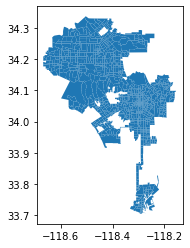

In [52]:
#check to see if transition was successful
census.plot()

In [53]:
#Remove non-visible rows
census.dropna(inplace=True)

In [54]:
#check to see if transition was successful
census

,FIPS,Census Tract,Total Population,Population Density (Per Sq. Mile),Area (Land),Total Population:,Total Population: Under 5 Years,Total Population: 5 to 9 Years,Total Population: 10 to 14 Years,Total Population: 15 to 17 Years,...,% Total Population: Foreign Born: Naturalized Citizen,% Total Population: Foreign Born: Not a Citizen,% Foreign-Born Population: 2010 or Later,% Foreign-Born Population: 2000 to 2009,% Foreign-Born Population: 1990 to 1999,% Foreign-Born Population: Before 1990,District,POP,TOOLTIP_1,geometry
1,06037101110,101110,4283,9710.18,0.441083510811633,4283,283,259,200,132,...,20.64,12.61,15.24,25.49,23.38,35.88,7.0,4731.0,Tract: 1011.10\nTotal Population: 4731,"POLYGON ((-118.29793 34.26323, -118.29697 34.2..."
2,06037101122,101122,3405,3335.385,1.02087152527348,3405,78,105,234,12,...,21.91,1.88,5.56,5.8,40.49,48.15,7.0,3664.0,Tract: 1011.22\nTotal Population: 3664,"POLYGON ((-118.27743 34.25991, -118.27747 34.2..."
3,06037101210,101210,6347,25263.42,0.251232824244746,6347,422,477,383,198,...,30.63,19.27,8.56,35.4,24.31,31.73,7.0,5990.0,Tract: 1012.10\nTotal Population: 5990,"POLYGON ((-118.28594 34.25590, -118.28594 34.2..."
4,06037101220,101220,3702,13719.17,0.269841404670601,3702,138,162,309,142,...,33.5,13.75,10.52,27.73,26.01,35.73,7.0,3363.0,Tract: 1012.20\nTotal Population: 3363,"POLYGON ((-118.27818 34.25577, -118.27824 34.2..."
5,06037101300,101300,3884,3897.202,0.996612339516631,3884,89,214,93,43,...,32.98,9.71,11.58,17.07,19,52.35,7.0,4199.0,Tract: 1013.00\nTotal Population: 4199,"POLYGON ((-118.26528 34.25238, -118.26531 34.2..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2635,06037980024,980024,223,72.20638,3.08836990750536,223,16,25,9,0,...,8.52,1.79,0,34.78,43.48,21.74,5.0,186.0,Tract: 9800.24\nTotal Population: 186,"MULTIPOLYGON (((-118.46942 34.16092, -118.4693..."
2636,06037980024,980024,223,72.20638,3.08836990750536,223,16,25,9,0,...,8.52,1.79,0,34.78,43.48,21.74,4.0,186.0,Tract: 9800.24\nTotal Population: 186,"MULTIPOLYGON (((-118.46917 34.17875, -118.4696..."
2638,06037980026,980026,26,4.856592,5.35354874231078,26,0,0,0,15,...,0,0,,,,,7.0,20.0,Tract: 9800.26\nTotal Population: 20,"POLYGON ((-118.26528 34.25238, -118.26539 34.2..."
2639,06037980028,980028,0,0,6.67946106314006,0,0,0,0,0,...,,,,,,,11.0,4.0,Tract: 9800.28\nTotal Population: 4,"POLYGON ((-118.38574 33.95531, -118.38586 33.9..."


In [55]:
list(census)

['FIPS',
 'Census Tract',
 'Total Population',
 'Population Density (Per Sq. Mile)',
 'Area (Land)',
 'Total Population:',
 'Total Population: Under 5 Years',
 'Total Population: 5 to 9 Years',
 'Total Population: 10 to 14 Years',
 'Total Population: 15 to 17 Years',
 'Total Population: 18 to 24 Years',
 'Total Population: 25 to 34 Years',
 'Total Population: 35 to 44 Years',
 'Total Population: 45 to 54 Years',
 'Total Population: 55 to 64 Years',
 'Total Population: 65 to 74 Years',
 'Total Population: 75 to 84 Years',
 'Total Population: 85 Years and Over',
 '% Population 25 Years and Over: Less than High School',
 '% Population 25 Years and Over: High School Graduate (Includes Equivalency)',
 '% Population 25 Years and Over: Some College',
 "% Population 25 Years and Over: Bachelor's Degree",
 "% Population 25 Years and Over: Master's Degree",
 '% Population 25 Years and Over: Professional School Degree',
 '% Population 25 Years and Over: Doctorate Degree',
 '% Population 3 Years a

In [56]:
#create % without high school education from census
edu1 = ['FIPS',
        'Census Tract',
        'Population Density (Per Sq. Mile)',
        'Total Population',
        '% Population 25 Years and Over: Less than High School',
        'geometry']

In [57]:
census_edu1 = census[edu1]

In [58]:
#there are some empty cells in the data that the NaN didn't drop, must find them and drop to continue
census_edu1['% Population 25 Years and Over: Less than High School'].replace('', np.nan, inplace=True)

/opt/conda/lib/python3.9/site-packages/pandas/core/generic.py:6619: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return self._update_inplace(result)


In [59]:
census_edu1.dropna(inplace=True)

/opt/conda/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [60]:
census_edu1

,FIPS,Census Tract,Population Density (Per Sq. Mile),Total Population,% Population 25 Years and Over: Less than High School,geometry
1,06037101110,101110,9710.18,4283,15.17,"POLYGON ((-118.29793 34.26323, -118.29697 34.2..."
2,06037101122,101122,3335.385,3405,6.1,"POLYGON ((-118.27743 34.25991, -118.27747 34.2..."
3,06037101210,101210,25263.42,6347,16.06,"POLYGON ((-118.28594 34.25590, -118.28594 34.2..."
4,06037101220,101220,13719.17,3702,19.92,"POLYGON ((-118.27818 34.25577, -118.27824 34.2..."
5,06037101300,101300,3897.202,3884,10.24,"POLYGON ((-118.26528 34.25238, -118.26531 34.2..."
...,...,...,...,...,...,...
2634,06037980024,980024,72.20638,223,3.16,"POLYGON ((-118.47381 34.18560, -118.47381 34.1..."
2635,06037980024,980024,72.20638,223,3.16,"MULTIPOLYGON (((-118.46942 34.16092, -118.4693..."
2636,06037980024,980024,72.20638,223,3.16,"MULTIPOLYGON (((-118.46917 34.17875, -118.4696..."
2638,06037980026,980026,4.856592,26,0,"POLYGON ((-118.26528 34.25238, -118.26539 34.2..."


In [61]:
census_edu1['% Population 25 Years and Over: Less than High School']=census_edu1['% Population 25 Years and Over: Less than High School'].astype(float)
census_edu1.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1301 entries, 1 to 2641
Data columns (total 6 columns):
 #   Column                                                 Non-Null Count  Dtype   
---  ------                                                 --------------  -----   
 0   FIPS                                                   1301 non-null   object  
 1   Census Tract                                           1301 non-null   object  
 2   Population Density (Per Sq. Mile)                      1301 non-null   object  
 3   Total Population                                       1301 non-null   object  
 4   % Population 25 Years and Over: Less than High School  1301 non-null   float64 
 5   geometry                                               1301 non-null   geometry
dtypes: float64(1), geometry(1), object(4)
memory usage: 71.1+ KB


/opt/conda/lib/python3.9/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [62]:
#create variable for percent of children not enrolled in school
edu2 = ['FIPS',
        'Census Tract',
        '% Population 3 Years and Over: Not Enrolled in School',
        'geometry']

In [63]:
census_edu2 = census[edu2]

In [64]:
census_edu2['% Population 3 Years and Over: Not Enrolled in School'].replace('', np.nan, inplace=True)

/opt/conda/lib/python3.9/site-packages/pandas/core/generic.py:6619: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return self._update_inplace(result)


In [65]:
census_edu1.dropna(inplace=True)

/opt/conda/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [66]:
census_edu2['% Population 3 Years and Over: Not Enrolled in School']=census_edu2['% Population 3 Years and Over: Not Enrolled in School'].astype(float)
census_edu2.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1309 entries, 1 to 2641
Data columns (total 4 columns):
 #   Column                                                 Non-Null Count  Dtype   
---  ------                                                 --------------  -----   
 0   FIPS                                                   1309 non-null   object  
 1   Census Tract                                           1309 non-null   object  
 2   % Population 3 Years and Over: Not Enrolled in School  1303 non-null   float64 
 3   geometry                                               1309 non-null   geometry
dtypes: float64(1), geometry(1), object(2)
memory usage: 51.1+ KB


In [67]:
edu3 = ['FIPS',
        'Census Tract',
        '% Civilian Population 16 to 19 Years: Not High School Graduate, Not Enrolled (Dropped Out)',
        'geometry']

In [68]:
census_edu3 = census[edu3]

In [69]:
census_edu3['% Civilian Population 16 to 19 Years: Not High School Graduate, Not Enrolled (Dropped Out)'].replace('', np.nan, inplace=True)

In [70]:
census_edu3.dropna(inplace=True)

In [71]:
census_edu3['% Civilian Population 16 to 19 Years: Not High School Graduate, Not Enrolled (Dropped Out)']=census_edu3['% Civilian Population 16 to 19 Years: Not High School Graduate, Not Enrolled (Dropped Out)'].astype(float)
census_edu3.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1273 entries, 1 to 2638
Data columns (total 4 columns):
 #   Column                                                                                      Non-Null Count  Dtype   
---  ------                                                                                      --------------  -----   
 0   FIPS                                                                                        1273 non-null   object  
 1   Census Tract                                                                                1273 non-null   object  
 2   % Civilian Population 16 to 19 Years: Not High School Graduate, Not Enrolled (Dropped Out)  1273 non-null   float64 
 3   geometry                                                                                    1273 non-null   geometry
dtypes: float64(1), geometry(1), object(2)
memory usage: 49.7+ KB


In [72]:
#create Foreign Born variable 
fb = ['FIPS',
        'Census Tract',
        '% Total Population: Foreign Born',
        'Population Density (Per Sq. Mile)',
        'geometry']

In [73]:
census_fb = census[fb]

In [74]:
census_fb['% Total Population: Foreign Born'].replace('', np.nan, inplace=True)

In [75]:
census_fb['% Total Population: Foreign Born']=census_fb['% Total Population: Foreign Born'].astype(float)
census_fb['Population Density (Per Sq. Mile)']=census_fb['Population Density (Per Sq. Mile)'].astype(float)
census_fb.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1309 entries, 1 to 2641
Data columns (total 5 columns):
 #   Column                             Non-Null Count  Dtype   
---  ------                             --------------  -----   
 0   FIPS                               1309 non-null   object  
 1   Census Tract                       1309 non-null   object  
 2   % Total Population: Foreign Born   1303 non-null   float64 
 3   Population Density (Per Sq. Mile)  1309 non-null   float64 
 4   geometry                           1309 non-null   geometry
dtypes: float64(2), geometry(1), object(2)
memory usage: 61.4+ KB


In [76]:
#create an age variable from the larger census dataframe
age2 = ['FIPS',
       'Census Tract',
       'Total Population:',
       'Total Population: Under 5 Years',
       'Total Population: 5 to 9 Years',
       'Total Population: 10 to 14 Years',
       'Total Population: 15 to 17 Years',
       'Total Population: 18 to 24 Years',
       'Total Population: 25 to 34 Years',
       'Total Population: 35 to 44 Years',
       'Total Population: 45 to 54 Years',
       'Total Population: 55 to 64 Years',
       'Total Population: 65 to 74 Years',
       'Total Population: 75 to 84 Years',
       'geometry']

In [77]:
census_age = census[age2]

In [78]:
census_age.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1309 entries, 1 to 2641
Data columns (total 15 columns):
 #   Column                            Non-Null Count  Dtype   
---  ------                            --------------  -----   
 0   FIPS                              1309 non-null   object  
 1   Census Tract                      1309 non-null   object  
 2   Total Population:                 1309 non-null   object  
 3   Total Population: Under 5 Years   1309 non-null   object  
 4   Total Population: 5 to 9 Years    1309 non-null   object  
 5   Total Population: 10 to 14 Years  1309 non-null   object  
 6   Total Population: 15 to 17 Years  1309 non-null   object  
 7   Total Population: 18 to 24 Years  1309 non-null   object  
 8   Total Population: 25 to 34 Years  1309 non-null   object  
 9   Total Population: 35 to 44 Years  1309 non-null   object  
 10  Total Population: 45 to 54 Years  1309 non-null   object  
 11  Total Population: 55 to 64 Years  1309 non-null 

In [79]:
#Change data type from object to integer 
census_age['Total Population:'] = census_age['Total Population:'].astype(int)
census_age['Total Population: Under 5 Years'] = census_age['Total Population: Under 5 Years'].astype(int)
census_age['Total Population: 5 to 9 Years'] = census_age['Total Population: 5 to 9 Years'].astype(int)
census_age['Total Population: 10 to 14 Years'] = census_age['Total Population: 10 to 14 Years'].astype(int)
census_age['Total Population: 15 to 17 Years'] = census_age['Total Population: 15 to 17 Years'].astype(int)
census_age['Total Population: 18 to 24 Years'] = census_age['Total Population: 18 to 24 Years'].astype(int)
census_age['Total Population: 25 to 34 Years'] = census_age['Total Population: 25 to 34 Years'].astype(int)
census_age['Total Population: 35 to 44 Years'] = census_age['Total Population: 35 to 44 Years'].astype(int)
census_age['Total Population: 45 to 54 Years'] = census_age['Total Population: 45 to 54 Years'].astype(int)
census_age['Total Population: 55 to 64 Years'] = census_age['Total Population: 55 to 64 Years'].astype(int)
census_age['Total Population: 65 to 74 Years'] = census_age['Total Population: 65 to 74 Years'].astype(int)
census_age['Total Population: 75 to 84 Years'] = census_age['Total Population: 75 to 84 Years'].astype(int)

In [80]:
#simplify the age categories 
census_age['Under 18'] = census_age['Total Population: Under 5 Years'] + census_age['Total Population: 5 to 9 Years'] + census_age['Total Population: 10 to 14 Years'] + census_age['Total Population: 15 to 17 Years']
census_age['18 to 34'] = census_age['Total Population: 18 to 24 Years']  + census_age['Total Population: 25 to 34 Years']
census_age['35 to 64'] = census_age['Total Population: 35 to 44 Years'] + census_age['Total Population: 45 to 54 Years'] + census_age['Total Population: 55 to 64 Years']
census_age['Over 65'] =  census_age['Total Population: 65 to 74 Years'] + census_age['Total Population: 75 to 84 Years']

In [81]:
census_age.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1309 entries, 1 to 2641
Data columns (total 19 columns):
 #   Column                            Non-Null Count  Dtype   
---  ------                            --------------  -----   
 0   FIPS                              1309 non-null   object  
 1   Census Tract                      1309 non-null   object  
 2   Total Population:                 1309 non-null   int64   
 3   Total Population: Under 5 Years   1309 non-null   int64   
 4   Total Population: 5 to 9 Years    1309 non-null   int64   
 5   Total Population: 10 to 14 Years  1309 non-null   int64   
 6   Total Population: 15 to 17 Years  1309 non-null   int64   
 7   Total Population: 18 to 24 Years  1309 non-null   int64   
 8   Total Population: 25 to 34 Years  1309 non-null   int64   
 9   Total Population: 35 to 44 Years  1309 non-null   int64   
 10  Total Population: 45 to 54 Years  1309 non-null   int64   
 11  Total Population: 55 to 64 Years  1309 non-null 

In [82]:
#simplify the columns
age_col2keep = ['FIPS',
                'Census Tract',
                'Total Population:',
                'Under 18',
                '18 to 34',
                '35 to 64',
                'Over 65',
                'geometry']

In [83]:
#redefine the columns
census_age = census_age[age_col2keep]

In [84]:
census_age.head()

,FIPS,Census Tract,Total Population:,Under 18,18 to 34,35 to 64,Over 65,geometry
1,06037101110,101110,4283,874,943,1739,649,"POLYGON ((-118.29793 34.26323, -118.29697 34.2..."
2,06037101122,101122,3405,429,824,1472,636,"POLYGON ((-118.27743 34.25991, -118.27747 34.2..."
3,06037101210,101210,6347,1480,1499,2744,573,"POLYGON ((-118.28594 34.25590, -118.28594 34.2..."
4,06037101220,101220,3702,751,808,1547,533,"POLYGON ((-118.27818 34.25577, -118.27824 34.2..."
5,06037101300,101300,3884,439,642,1863,714,"POLYGON ((-118.26528 34.25238, -118.26531 34.2..."


In [85]:
#normalize the data into percentages for mapping
census_age['Percent under 18']=census_age['Under 18']/census_age['Total Population:']*100
census_age['Percent 18 to 34']=census_age['18 to 34']/census_age['Total Population:']*100
census_age['Percent 35 to 64']=census_age['35 to 64']/census_age['Total Population:']*100
census_age['Percent over 65']=census_age['Over 65']/census_age['Total Population:']*100

In [86]:
census_age.head()

,FIPS,Census Tract,Total Population:,Under 18,18 to 34,35 to 64,Over 65,geometry,Percent under 18,Percent 18 to 34,Percent 35 to 64,Percent over 65
1,06037101110,101110,4283,874,943,1739,649,"POLYGON ((-118.29793 34.26323, -118.29697 34.2...",20.406257,22.017278,40.602382,15.152930
2,06037101122,101122,3405,429,824,1472,636,"POLYGON ((-118.27743 34.25991, -118.27747 34.2...",12.599119,24.199706,43.230543,18.678414
3,06037101210,101210,6347,1480,1499,2744,573,"POLYGON ((-118.28594 34.25590, -118.28594 34.2...",23.318103,23.617457,43.233023,9.027887
4,06037101220,101220,3702,751,808,1547,533,"POLYGON ((-118.27818 34.25577, -118.27824 34.2...",20.286332,21.826040,41.788223,14.397623
5,06037101300,101300,3884,439,642,1863,714,"POLYGON ((-118.26528 34.25238, -118.26531 34.2...",11.302781,16.529351,47.966014,18.383110


In [87]:
age_col2keep2 = ['FIPS',
                 'Census Tract',
                 'Percent under 18',
                 'Percent 18 to 34',
                 'Percent 35 to 64',
                 'Percent over 65',
                 'geometry']

In [88]:
census_age = census_age[age_col2keep2]

In [89]:
census_age.head()

,FIPS,Census Tract,Percent under 18,Percent 18 to 34,Percent 35 to 64,Percent over 65,geometry
1,06037101110,101110,20.406257,22.017278,40.602382,15.152930,"POLYGON ((-118.29793 34.26323, -118.29697 34.2..."
2,06037101122,101122,12.599119,24.199706,43.230543,18.678414,"POLYGON ((-118.27743 34.25991, -118.27747 34.2..."
3,06037101210,101210,23.318103,23.617457,43.233023,9.027887,"POLYGON ((-118.28594 34.25590, -118.28594 34.2..."
4,06037101220,101220,20.286332,21.826040,41.788223,14.397623,"POLYGON ((-118.27818 34.25577, -118.27824 34.2..."
5,06037101300,101300,11.302781,16.529351,47.966014,18.383110,"POLYGON ((-118.26528 34.25238, -118.26531 34.2..."


In [90]:
census_age.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1309 entries, 1 to 2641
Data columns (total 7 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   FIPS              1309 non-null   object  
 1   Census Tract      1309 non-null   object  
 2   Percent under 18  1303 non-null   float64 
 3   Percent 18 to 34  1303 non-null   float64 
 4   Percent 35 to 64  1303 non-null   float64 
 5   Percent over 65   1303 non-null   float64 
 6   geometry          1309 non-null   geometry
dtypes: float64(4), geometry(1), object(2)
memory usage: 81.8+ KB


In [91]:
#create a density data frame
density = ['FIPS',
            'Census Tract',
            'Population Density (Per Sq. Mile)',
            'geometry']

In [92]:
census_dens = census[density]

In [93]:
census_dens.head()

,FIPS,Census Tract,Population Density (Per Sq. Mile),geometry
1,06037101110,101110,9710.18,"POLYGON ((-118.29793 34.26323, -118.29697 34.2..."
2,06037101122,101122,3335.385,"POLYGON ((-118.27743 34.25991, -118.27747 34.2..."
3,06037101210,101210,25263.42,"POLYGON ((-118.28594 34.25590, -118.28594 34.2..."
4,06037101220,101220,13719.17,"POLYGON ((-118.27818 34.25577, -118.27824 34.2..."
5,06037101300,101300,3897.202,"POLYGON ((-118.26528 34.25238, -118.26531 34.2..."


In [94]:
census_dens.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1309 entries, 1 to 2641
Data columns (total 4 columns):
 #   Column                             Non-Null Count  Dtype   
---  ------                             --------------  -----   
 0   FIPS                               1309 non-null   object  
 1   Census Tract                       1309 non-null   object  
 2   Population Density (Per Sq. Mile)  1309 non-null   object  
 3   geometry                           1309 non-null   geometry
dtypes: geometry(1), object(3)
memory usage: 51.1+ KB


In [95]:
census_dens['Population Density (Per Sq. Mile)'] = census_dens['Population Density (Per Sq. Mile)'].astype(float)

/opt/conda/lib/python3.9/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [96]:
#create an income variable from census data
income = ['FIPS',
          'Census Tract',
          'Households:',
          'Households: Less than $10,000',
          'Households: $10,000 to $14,999',
          'Households: $15,000 to $19,999', 
          'Households: $20,000 to $24,999',
          'Households: $25,000 to $29,999',
          'Households: $30,000 to $34,999',
          'Households: $35,000 to $39,999',
          'Households: $40,000 to $44,999',
          'Households: $45,000 to $49,999',
          'Households: $50,000 to $59,999',
          'Households: $60,000 to $74,999',
          'Households: $75,000 to $99,999',
          'Households: $100,000 to $124,999',
          'Households: $125,000 to $149,999',
          'Households: $150,000 to $199,999',
          'Households: $200,000 or More',
          'geometry']

In [97]:
census_inc = census[income]

In [98]:
census_inc.head()

,FIPS,Census Tract,Households:,"Households: Less than $10,000","Households: $10,000 to $14,999","Households: $15,000 to $19,999","Households: $20,000 to $24,999","Households: $25,000 to $29,999","Households: $30,000 to $34,999","Households: $35,000 to $39,999","Households: $40,000 to $44,999","Households: $45,000 to $49,999","Households: $50,000 to $59,999","Households: $60,000 to $74,999","Households: $75,000 to $99,999","Households: $100,000 to $124,999","Households: $125,000 to $149,999","Households: $150,000 to $199,999","Households: $200,000 or More",geometry
1,06037101110,101110,1575,86,91,101,44,55,78,67,46,99,99,107,274,151,75,125,77,"POLYGON ((-118.29793 34.26323, -118.29697 34.2..."
2,06037101122,101122,1312,66,21,0,47,36,25,7,0,52,34,166,298,119,146,115,180,"POLYGON ((-118.27743 34.25991, -118.27747 34.2..."
3,06037101210,101210,2297,271,135,278,39,108,169,112,53,178,163,165,261,148,106,53,58,"POLYGON ((-118.28594 34.25590, -118.28594 34.2..."
4,06037101220,101220,1357,85,128,124,57,35,94,83,107,83,84,63,122,114,68,69,41,"POLYGON ((-118.27818 34.25577, -118.27824 34.2..."
5,06037101300,101300,1445,78,18,59,33,68,33,17,83,32,86,147,195,137,122,159,178,"POLYGON ((-118.26528 34.25238, -118.26531 34.2..."


In [99]:
#convert to integers
census_inc['Households:'] = census_inc['Households:'].astype(int)
census_inc['Households: Less than $10,000'] = census_inc['Households: Less than $10,000'].astype(int)
census_inc['Households: $10,000 to $14,999'] = census_inc['Households: $10,000 to $14,999'].astype(int)
census_inc['Households: $15,000 to $19,999'] = census_inc['Households: $15,000 to $19,999'].astype(int)
census_inc['Households: $20,000 to $24,999'] = census_inc['Households: $20,000 to $24,999'].astype(int)
census_inc['Households: $25,000 to $29,999'] = census_inc['Households: $25,000 to $29,999'].astype(int)
census_inc['Households: $30,000 to $34,999'] = census_inc['Households: $30,000 to $34,999'].astype(int)
census_inc['Households: $35,000 to $39,999'] = census_inc['Households: $35,000 to $39,999'].astype(int)
census_inc['Households: $40,000 to $44,999'] = census_inc['Households: $40,000 to $44,999'].astype(int)
census_inc['Households: $45,000 to $49,999'] = census_inc['Households: $45,000 to $49,999'].astype(int)
census_inc['Households: $50,000 to $59,999'] = census_inc['Households: $50,000 to $59,999'].astype(int)
census_inc['Households: $60,000 to $74,999'] = census_inc['Households: $60,000 to $74,999'].astype(int)
census_inc['Households: $75,000 to $99,999'] = census_inc['Households: $75,000 to $99,999'].astype(int)
census_inc['Households: $100,000 to $124,999'] = census_inc['Households: $100,000 to $124,999'].astype(int)
census_inc['Households: $125,000 to $149,999'] = census_inc['Households: $125,000 to $149,999'].astype(int)
census_inc['Households: $150,000 to $199,999'] = census_inc['Households: $150,000 to $199,999'].astype(int)
census_inc['Households: $200,000 or More'] = census_inc['Households: $200,000 or More'].astype(int)

/opt/conda/lib/python3.9/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [100]:
#simplify the income brackets
census_inc['Less than $30k'] = census_inc['Households: Less than $10,000'] + census_inc['Households: $10,000 to $14,999'] + census_inc['Households: $15,000 to $19,999'] + census_inc['Households: $20,000 to $24,999'] + census_inc['Households: $25,000 to $29,999']
census_inc['$30k to $75k'] = census_inc['Households: $30,000 to $34,999'] + census_inc['Households: $35,000 to $39,999'] + census_inc['Households: $40,000 to $44,999'] + census_inc['Households: $45,000 to $49,999'] + census_inc['Households: $50,000 to $59,999'] + census_inc['Households: $60,000 to $74,999']
census_inc['$75k to $150k'] = census_inc['Households: $75,000 to $99,999'] + census_inc['Households: $100,000 to $124,999'] + census_inc['Households: $125,000 to $149,999'] 
census_inc['Over $150k'] =  census_inc['Households: $150,000 to $199,999'] + census_inc['Households: $200,000 or More']

In [101]:
census_inc.head()

,FIPS,Census Tract,Households:,"Households: Less than $10,000","Households: $10,000 to $14,999","Households: $15,000 to $19,999","Households: $20,000 to $24,999","Households: $25,000 to $29,999","Households: $30,000 to $34,999","Households: $35,000 to $39,999",...,"Households: $75,000 to $99,999","Households: $100,000 to $124,999","Households: $125,000 to $149,999","Households: $150,000 to $199,999","Households: $200,000 or More",geometry,Less than $30k,$30k to $75k,$75k to $150k,Over $150k
1,06037101110,101110,1575,86,91,101,44,55,78,67,...,274,151,75,125,77,"POLYGON ((-118.29793 34.26323, -118.29697 34.2...",377,496,500,202
2,06037101122,101122,1312,66,21,0,47,36,25,7,...,298,119,146,115,180,"POLYGON ((-118.27743 34.25991, -118.27747 34.2...",170,284,563,295
3,06037101210,101210,2297,271,135,278,39,108,169,112,...,261,148,106,53,58,"POLYGON ((-118.28594 34.25590, -118.28594 34.2...",831,840,515,111
4,06037101220,101220,1357,85,128,124,57,35,94,83,...,122,114,68,69,41,"POLYGON ((-118.27818 34.25577, -118.27824 34.2...",429,514,304,110
5,06037101300,101300,1445,78,18,59,33,68,33,17,...,195,137,122,159,178,"POLYGON ((-118.26528 34.25238, -118.26531 34.2...",256,398,454,337


In [102]:
income_col2keep = ['FIPS',
                   'Census Tract',
                   'Households:',
                   'Less than $30k',
                   '$30k to $75k',
                   '$75k to $150k',
                   'Over $150k',
                   'geometry']

In [103]:
census_inc = census_inc[income_col2keep]

In [104]:
census_inc.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1309 entries, 1 to 2641
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   FIPS            1309 non-null   object  
 1   Census Tract    1309 non-null   object  
 2   Households:     1309 non-null   int64   
 3   Less than $30k  1309 non-null   int64   
 4   $30k to $75k    1309 non-null   int64   
 5   $75k to $150k   1309 non-null   int64   
 6   Over $150k      1309 non-null   int64   
 7   geometry        1309 non-null   geometry
dtypes: geometry(1), int64(5), object(2)
memory usage: 92.0+ KB


In [105]:
#normaliza the data
census_inc['Percent less than $30k']=census_inc['Less than $30k']/census_inc['Households:']*100
census_inc['Percent $30k to $75k']=census_inc['$30k to $75k']/census_inc['Households:']*100
census_inc['Percent $75k to $150k']=census_inc['$75k to $150k']/census_inc['Households:']*100
census_inc['Percent over $150k']=census_inc['Over $150k']/census_inc['Households:']*100

In [106]:
census_inc.head()

,FIPS,Census Tract,Households:,Less than $30k,$30k to $75k,$75k to $150k,Over $150k,geometry,Percent less than $30k,Percent $30k to $75k,Percent $75k to $150k,Percent over $150k
1,06037101110,101110,1575,377,496,500,202,"POLYGON ((-118.29793 34.26323, -118.29697 34.2...",23.936508,31.492063,31.746032,12.825397
2,06037101122,101122,1312,170,284,563,295,"POLYGON ((-118.27743 34.25991, -118.27747 34.2...",12.957317,21.646341,42.911585,22.484756
3,06037101210,101210,2297,831,840,515,111,"POLYGON ((-118.28594 34.25590, -118.28594 34.2...",36.177623,36.569438,22.420549,4.832390
4,06037101220,101220,1357,429,514,304,110,"POLYGON ((-118.27818 34.25577, -118.27824 34.2...",31.613854,37.877671,22.402358,8.106116
5,06037101300,101300,1445,256,398,454,337,"POLYGON ((-118.26528 34.25238, -118.26531 34.2...",17.716263,27.543253,31.418685,23.321799


In [107]:
income_col2keep2 = ['FIPS',
                    'Census Tract',
                    'Percent less than $30k',
                    'Percent $30k to $75k',
                    'Percent $75k to $150k',
                    'Percent over $150k',
                    'geometry']

In [108]:
census_inc = census_inc[income_col2keep2]

## Visualizing the Data
Let's begin to visualize the data! This is hgher level data for the city so I think stacked bar graphs will be best to compare computer ownership and type of internet with the selected variable of age, educational attainment, and race.

### Creating Graphs and Charts

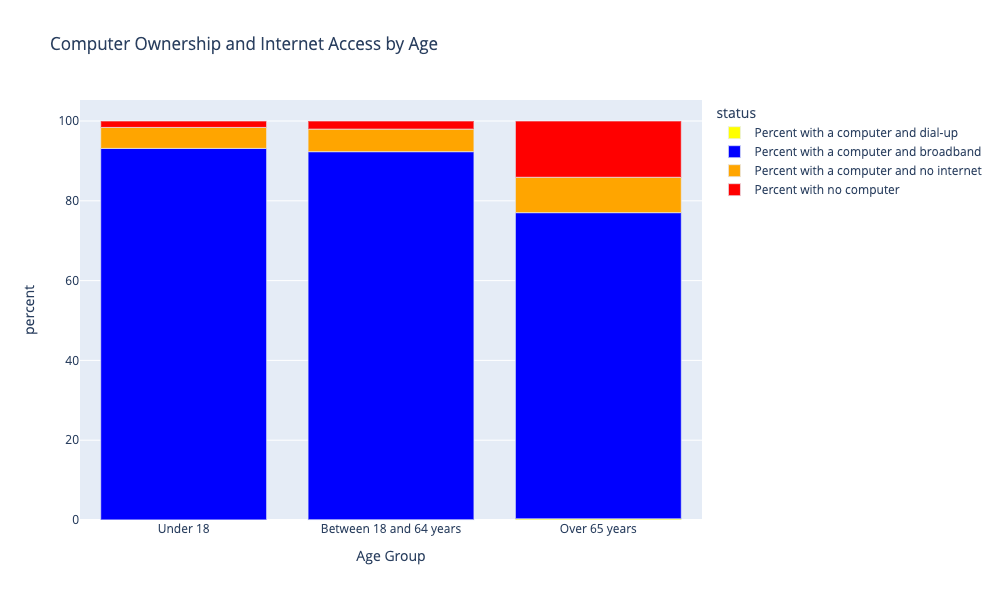

In [109]:
fig = px.bar(age,
             x = 'Age Group',
             y = 'percent',
             width=800,
             height=600,
             color = 'status',
             color_discrete_sequence = ['yellow','blue','orange','red'],
             title = 'Computer Ownership and Internet Access by Age',
)
fig.show()

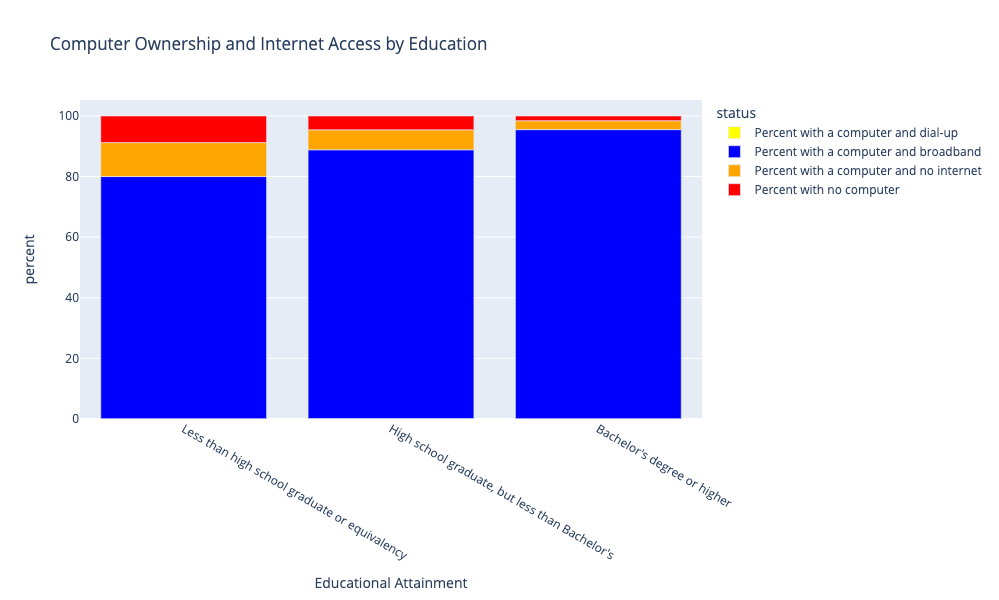

In [110]:
fig = px.bar(educ,
             x = 'Educational Attainment',
             y = 'percent',
             width=800,
             height=600,
             color = 'status',
             color_discrete_sequence = ['yellow','blue','orange','red'],
             title = 'Computer Ownership and Internet Access by Education',
)
fig.show()

In [111]:
#Currently I do not intended to normalize the race variable to demonstrate the magnitude of digital exclusion between groups. To do this, I need to change the data type for counts:
race['count']=race['count'].astype(int)
race.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   race    20 non-null     object
 1   status  20 non-null     object
 2   count   20 non-null     int64 
dtypes: int64(1), object(2)
memory usage: 608.0+ bytes


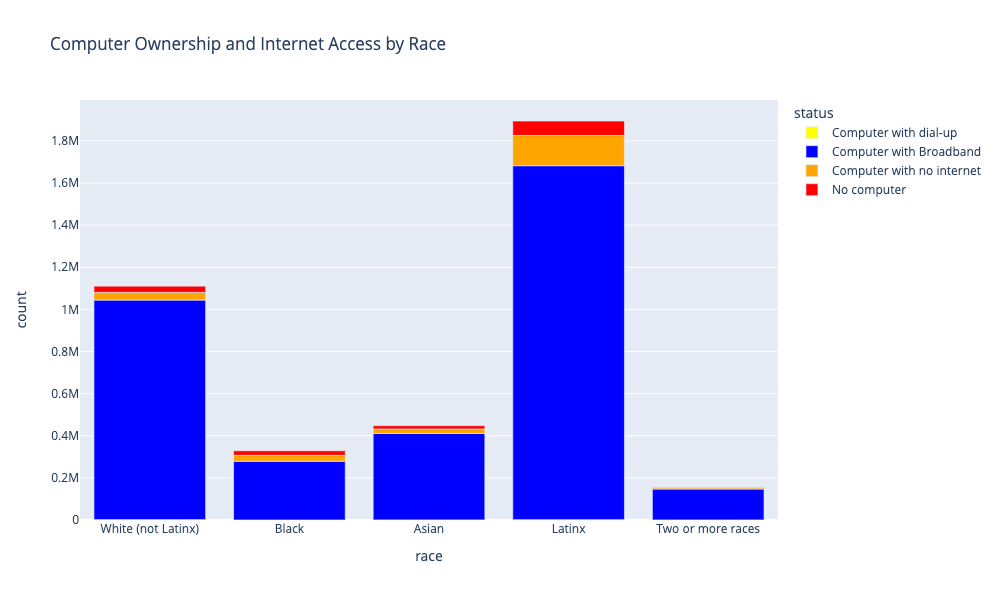

In [112]:
fig = px.bar(race,
             x = 'race',
             y = 'count',
             width = 800,
             height = 600,
             color = 'status',
             color_discrete_sequence = ['yellow','blue','orange','red'],
             title = 'Computer Ownership and Internet Access by Race',
)
fig.show()

### Mapping Internet Access

<AxesSubplot:>

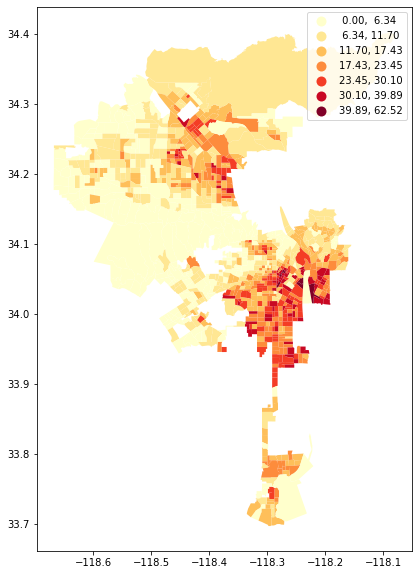

In [113]:
#Let's map some data!
hh.plot(figsize=(20,10),
        column = 'Percent with no internet access', 
        legend = True,
        scheme='naturalbreaks',
        cmap = 'YlOrRd',
        k=7)

<AxesSubplot:>

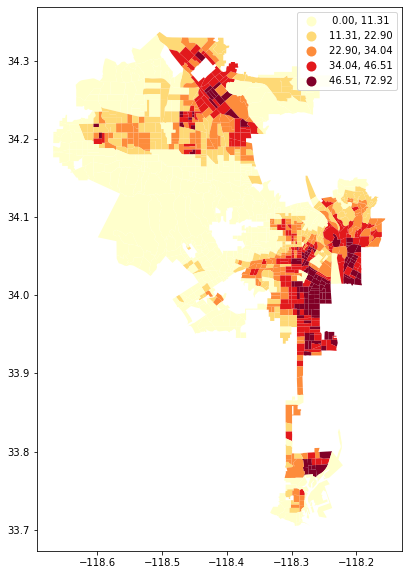

In [114]:
census_edu1.plot(figsize=(20,10),
        column = '% Population 25 Years and Over: Less than High School', 
        legend = True,
        scheme='naturalbreaks',
        cmap = 'YlOrRd')

<AxesSubplot:>

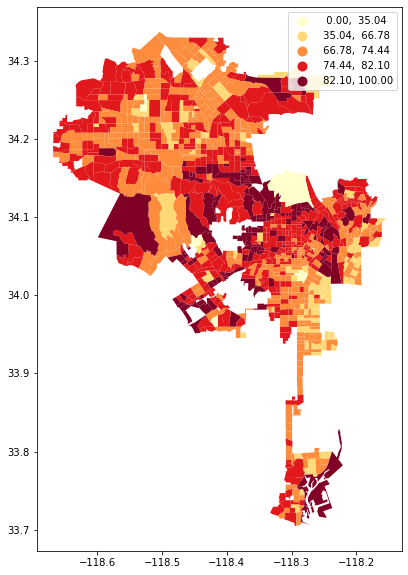

In [115]:
census_edu2.plot(figsize=(20,10),
        column = '% Population 3 Years and Over: Not Enrolled in School', 
        legend = True,
        scheme='naturalbreaks',
        cmap = 'YlOrRd')
#this looks alarming...like no children are in school, I need to understand this better before moving forward

<AxesSubplot:>

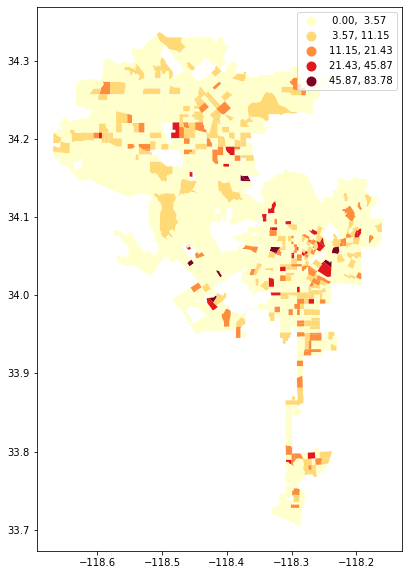

In [116]:
census_edu3.plot(figsize=(20,10),
        column = '% Civilian Population 16 to 19 Years: Not High School Graduate, Not Enrolled (Dropped Out)', 
        legend = True,
        scheme='naturalbreaks',
        cmap = 'YlOrRd')
# The value of this is questionable, will hold off using in further analysis

<AxesSubplot:>

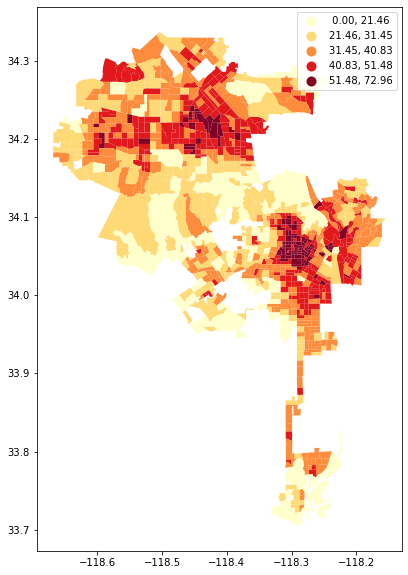

In [117]:
census_fb.plot(figsize=(20,10),
        column = '% Total Population: Foreign Born', 
        legend = True,
        scheme='naturalbreaks',
        cmap = 'YlOrRd')

<AxesSubplot:>

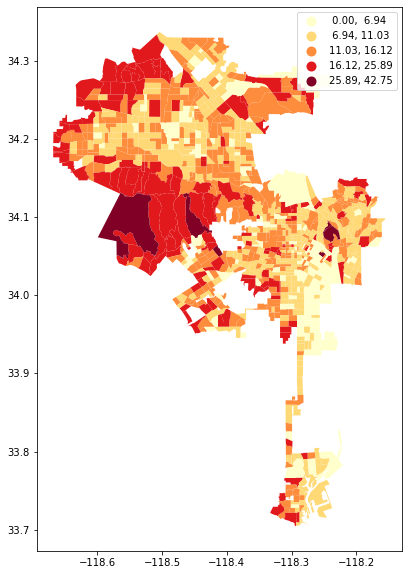

In [118]:
census_age.plot(figsize=(20,10),
        column = 'Percent over 65', 
        legend = True,
        scheme='naturalbreaks',
        cmap = 'YlOrRd')

<AxesSubplot:>

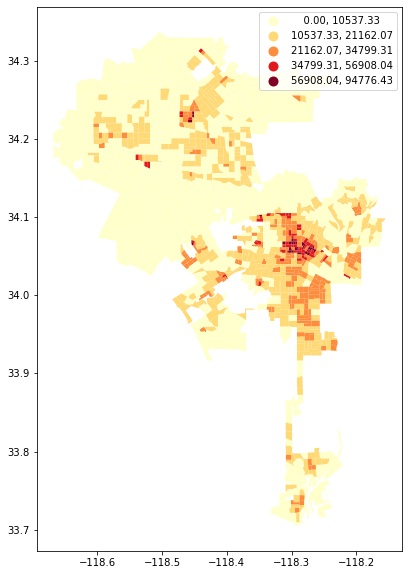

In [119]:
census_dens.plot(figsize=(20,10),
        column = 'Population Density (Per Sq. Mile)', 
        legend = True,
        scheme='naturalbreaks',
        cmap = 'YlOrRd')

<AxesSubplot:>

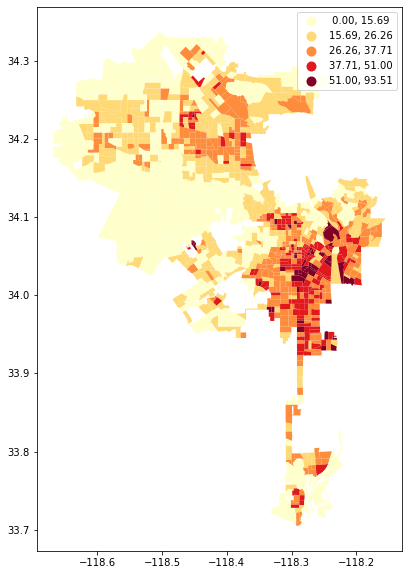

In [120]:
census_inc.plot(figsize=(20,10),
        column = 'Percent less than $30k', 
        legend = True,
        scheme='naturalbreaks',
        cmap = 'YlOrRd')

In [121]:
#let's kick it up a notch
hh_web_mercator = hh.to_crs(epsg=3857)                      

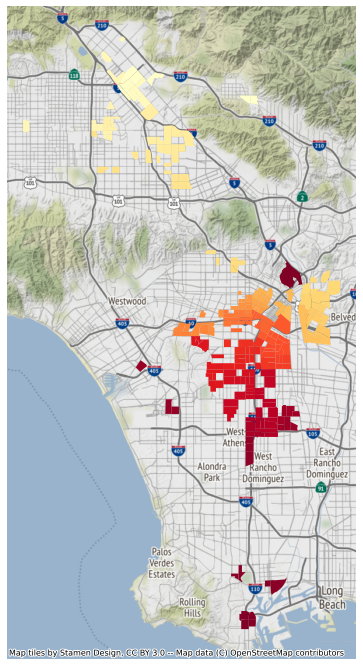

In [122]:
fig, ax = plt.subplots(figsize = (20, 12))
hh_web_mercator[hh_web_mercator['Percent with no internet access']>20].plot(ax=ax, scheme = 'naturalbreaks', cmap = 'YlOrRd', k=7)
ax.axis('off')
ctx.add_basemap(ax)

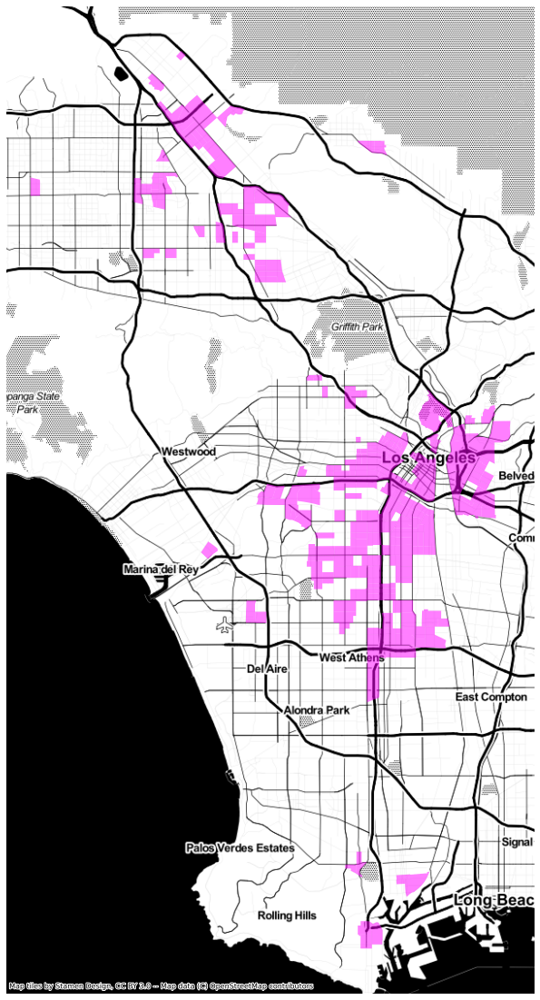

In [123]:
fig, ax = plt.subplots(figsize = (20, 20))
hh_web_mercator[hh_web_mercator['Percent with no internet access']>20].plot(ax=ax, color = '#ff00ff', alpha=0.5)
ax.axis('off')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner)

## Mapping locations (YK)

- convert lat/lon's to floats
- convert lib to geodataframe
- reproject to web mercator


In [124]:
lib['lat'] = lib['lat'].astype(float)
lib['lon'] = lib['lon'].astype(float)

In [125]:
lib_gdf = gpd.GeoDataFrame(
    lib, geometry=gpd.points_from_xy(lib.lon, lib.lat),crs="EPSG:4326")

In [126]:
lib_gdf = lib_gdf.to_crs(epsg=3857) 

In [127]:
list(census_fb)

['FIPS',
 'Census Tract',
 '% Total Population: Foreign Born',
 'Population Density (Per Sq. Mile)',
 'geometry']

In [128]:
census_fb = census_fb.to_crs(epsg=3857) 

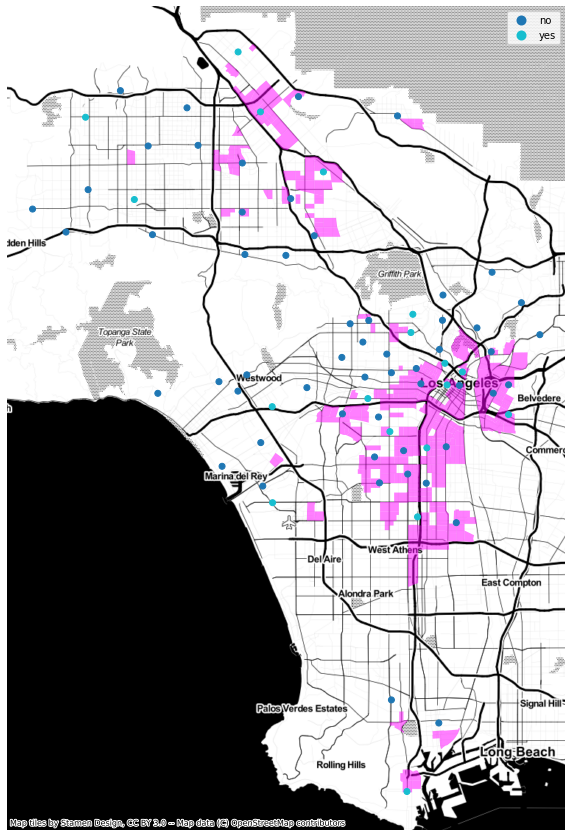

In [129]:
fig, ax = plt.subplots(figsize = (10, 20))
hh_web_mercator[hh_web_mercator['Percent with no internet access']>20].plot(ax=ax, color = '#ff00ff', alpha=0.5)
lib_gdf.plot(ax=ax,column='Hotspot Loan', legend= True)
ax.axis('off')
ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner)

#Thanks Yoh!

In [130]:
#Next, I will attempt to make an interactive version of the map above.

#mapbox access token
token = 'pk.eyJ1IjoidWNsYS1jcmlzdGVtYyIsImEiOiJja2w0czA1bXYxeWszMnFxbnc0djltd295In0.ocHbUsFaHy65rMNwCGi1lA'
px.set_mapbox_access_token(token)

In [131]:
mapboxstyle = 'mapbox://styles/ucla-cristemc/ckw04vi2m89am14m6hjfg0lrr'

In [132]:
hh_web_mercator2 = hh_web_mercator.to_crs('epsg:4326')

In [133]:
hh_col1 = hh_web_mercator2[('Percent with no internet access')]>20

In [134]:
#new variable containing only tracts with 20% or higher
hh_grt20 = hh_web_mercator2.sort_values(by='Percent with no internet access',ascending = False)

In [135]:
hh_grt20[['geoid','Percent with no internet access']].head(10)

,geoid,Percent with no internet access
536,14000US06037206300,62.515413
561,14000US06037208903,51.718213
569,14000US06037209402,49.105691
534,14000US06037206050,48.322981
562,14000US06037208904,44.771495
696,14000US06037224320,43.022222
528,14000US06037205110,42.357060
535,14000US06037206200,41.462401
544,14000US06037207502,39.890710
558,14000US06037208801,39.223153


In [136]:
#remove tracts with less than 20%
hh_grt20 = hh_grt20[hh_grt20['Percent with no internet access']>=20]

<AxesSubplot:>

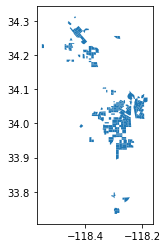

In [137]:
hh_grt20.plot()

In [138]:
hh_grt20.shape

(265, 7)

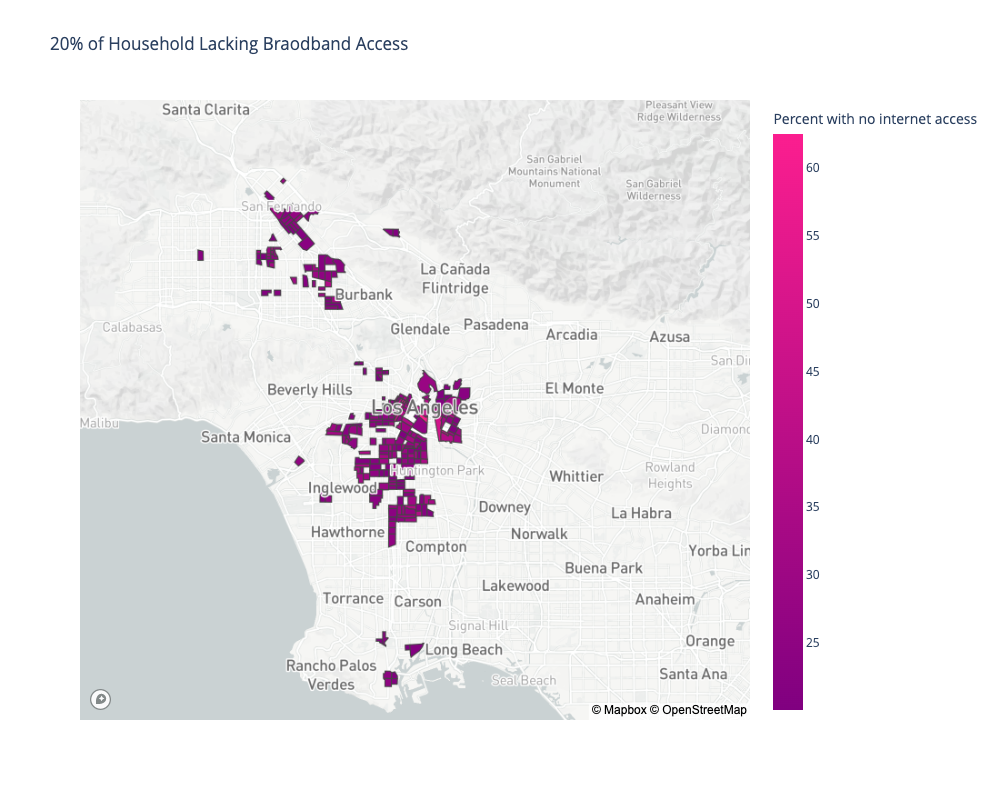

In [139]:
#Build off this map before continuing with other census data. I will use ploty & mapbox for a more rich experience
fig = px.choropleth_mapbox(hh_grt20, 
                     geojson=hh_grt20.geometry, 
                     locations= hh_grt20.index, 
                     color = hh_grt20['Percent with no internet access'],
                    # mapbox_style=mapboxstyle,
                     width = 1000,
                     height = 800,
                     zoom=9, 
                     center = {"lat": 34.0504, "lon": -118.2555},
                     color_continuous_scale=["purple","#FB1E8F"],
                     opacity=1,
                     title='20% of Household Lacking Braodband Access')
#fig.add_trace(px.scatter_mapbox(lib_gdf))
fig.update_traces(showlegend=False)
fig.show()

In [140]:
#Attempt 1: create a for loop through each row to calculate the centroid of each census tract

#se['geometry_cent'] = se['geometry'].centroid

In [141]:
#Attempt 2: create a for loop through each row to calculate the centroid of each census tract

census_edu1['geometry_cent'] = census_edu1['geometry'].centroid

/tmp/ipykernel_92/3448058929.py:3: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


/opt/conda/lib/python3.9/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [142]:
census_edu1

,FIPS,Census Tract,Population Density (Per Sq. Mile),Total Population,% Population 25 Years and Over: Less than High School,geometry,geometry_cent
1,06037101110,101110,9710.18,4283,15.17,"POLYGON ((-118.29793 34.26323, -118.29697 34.2...",POINT (-118.29300 34.25948)
2,06037101122,101122,3335.385,3405,6.10,"POLYGON ((-118.27743 34.25991, -118.27747 34.2...",POINT (-118.29016 34.26773)
3,06037101210,101210,25263.42,6347,16.06,"POLYGON ((-118.28594 34.25590, -118.28594 34.2...",POINT (-118.29074 34.25298)
4,06037101220,101220,13719.17,3702,19.92,"POLYGON ((-118.27818 34.25577, -118.27824 34.2...",POINT (-118.28164 34.25161)
5,06037101300,101300,3897.202,3884,10.24,"POLYGON ((-118.26528 34.25238, -118.26531 34.2...",POINT (-118.27101 34.24878)
...,...,...,...,...,...,...,...
2634,06037980024,980024,72.20638,223,3.16,"POLYGON ((-118.47381 34.18560, -118.47381 34.1...",POINT (-118.48850 34.17693)
2635,06037980024,980024,72.20638,223,3.16,"MULTIPOLYGON (((-118.46942 34.16092, -118.4693...",POINT (-118.49298 34.16860)
2636,06037980024,980024,72.20638,223,3.16,"MULTIPOLYGON (((-118.46917 34.17875, -118.4696...",POINT (-118.46949 34.17895)
2638,06037980026,980026,4.856592,26,0.00,"POLYGON ((-118.26528 34.25238, -118.26539 34.2...",POINT (-118.27924 34.27519)


In [143]:
census_edu1['Population Density (Per Sq. Mile)'] = census_edu1['Population Density (Per Sq. Mile)'].astype(float)
census_edu1['% Population 25 Years and Over: Less than High School'] = census_edu1['% Population 25 Years and Over: Less than High School'].astype(float)
census_edu1['Total Population'] = census_edu1['Total Population'].astype(float)

/opt/conda/lib/python3.9/site-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



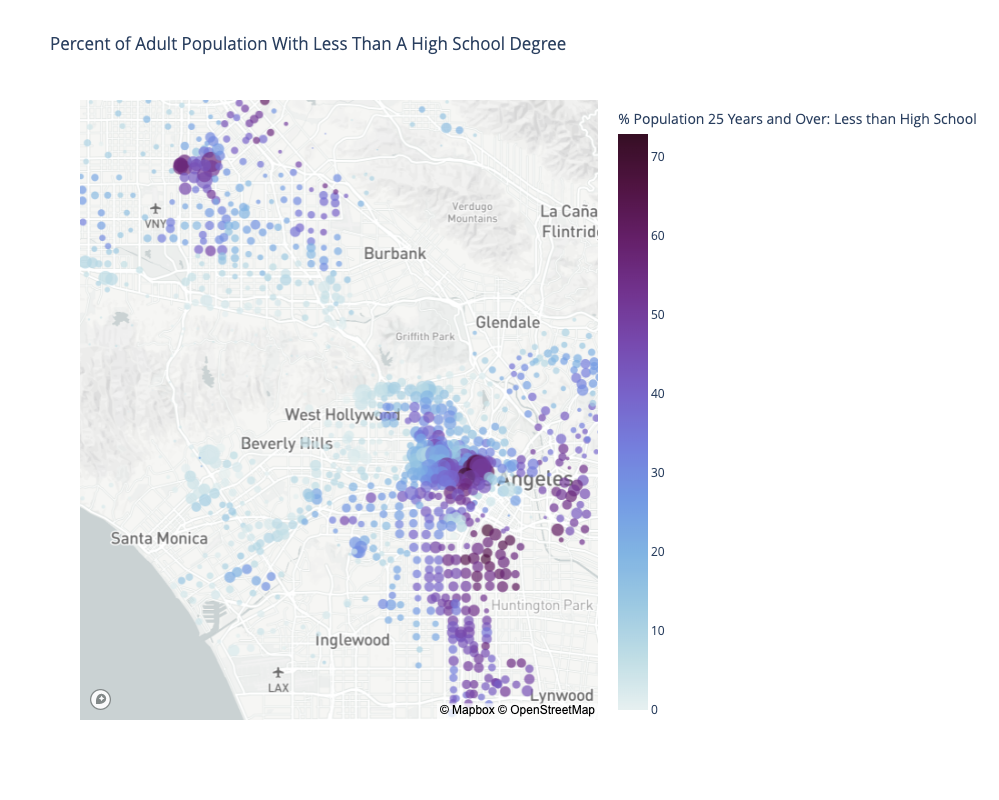

In [144]:
fig = px.scatter_mapbox(census_edu1, 
                        lat=census_edu1.geometry_cent.y,
                        lon=census_edu1.geometry_cent.x,     
                        color="% Population 25 Years and Over: Less than High School", 
                        size='Population Density (Per Sq. Mile)',
                        width = 1000,
                        height = 800,
                        size_max=15, 
                        zoom=10,
                        title='Percent of Adult Population With Less Than A High School Degree',
                        color_continuous_scale=px.colors.sequential.dense)
fig.show()

In [145]:
edu1_gdf = gpd.GeoDataFrame(
    census_edu1, geometry=gpd.points_from_xy(census_edu1.geometry_cent.x, census_edu1.geometry_cent.y),crs="EPSG:4326")

In [146]:
census_edu1 = census_edu1.to_crs(epsg=3857) 

#Currently in markdown to keep the file size smaller and loads more quickly
fig = px.scatter_mapbox(lib_gdf, lat="lat", lon='lon', color = "Hotspot Loan",
                    # mapbox_style=mapboxstyle,
                     width = 1000,
                     height = 800,
                     zoom=9, 
                     center = {"lat": 34.0504, "lon": -118.2555},
                     hover_name='Branch Name', 
                     hover_data=['Address', 
                                 'CityZip', 
                                 'Email', 
                                 'Phone Number'], 
                                 #'lat':False, Want to remove lat & lon because it is irrelevant info for most people
                                 #'lon':False],
                    #color_continuous_scale=deep,
                    title='Percent of Households Lacking Braodband Access')

fig_px = px.choropleth_mapbox(hh,
                              geojson=hh.geometry, 
                              locations= hh.index, 
                              color = hh['Percent with no internet access'],
                              #mapbox_style=mapboxstyle,
                              width = 1000,
                              height = 800,
                              zoom=9, 
                              center = {"lat": 34.0504, "lon": -118.2555},
                              #color_continuous_scale=deep,
                              opacity=0.7)
fig.add_trace(
    fig_px.data[0]
)
fig.show()

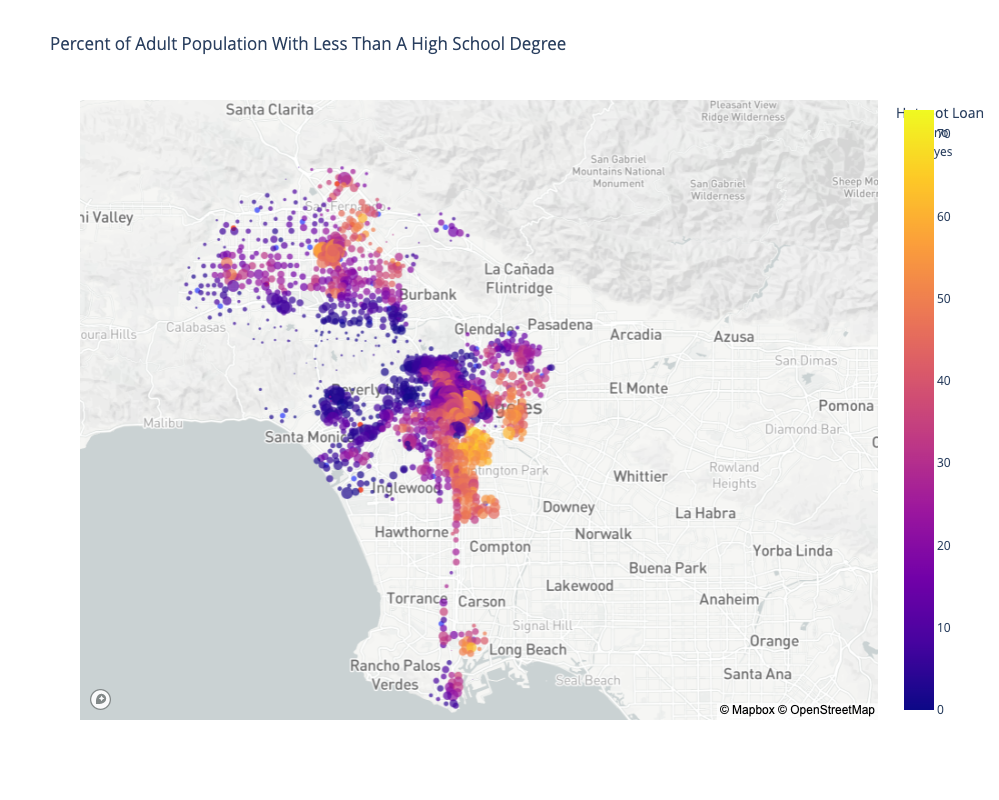

In [147]:
#Create map above but with census_edu1 data
#Currently in markdown to keep the file size smaller and loads more quickly
trace1 = px.scatter_mapbox(lib_gdf, lat="lat", lon='lon', color = "Hotspot Loan",
                    # mapbox_style=mapboxstyle,
                     width = 1000,
                     height = 800,
                     zoom=9, 
                     center = {"lat": 34.0504, "lon": -118.2555},
                     hover_name='Branch Name', 
                     hover_data=['Address', 
                                 'CityZip', 
                                 'Email', 
                                 'Phone Number'], 
                                 #'lat':False, Want to remove lat & lon because it is irrelevant info for most people
                                 #'lon':False],
                     #showlegend = False,
                     title='Percent of Adult Population With Less Than A High School Degree')
trace2 = px.scatter_mapbox(census_edu1, 
                        lat=census_edu1.geometry_cent.y,
                        lon=census_edu1.geometry_cent.x,     
                        color="% Population 25 Years and Over: Less than High School", 
                        size='Population Density (Per Sq. Mile)',
                        width = 1000,
                        height = 800,
                        size_max=15, 
                        zoom=10,
                        title='Percent of Adult Population With Less Than A High School Degree',
                        color_continuous_scale=px.colors.sequential.dense)
trace1.add_trace(
    trace2.data[0]
)
trace1.show()

In [215]:
# save as html file
trace1.write_html("census_edu1.html")

In [213]:
#I prefer the scatter plot over the chloropleth map, but the makers for the library are difficult to see. I am going to use a more robust plotly libary to alter the markers
trace1 = go.Figure(go.Scattermapbox(lib_gdf, mode = "markers", lat="lat", lon='lon', color = "Hotspot Loan",
                     width = 1000,
                     height = 800,
                     zoom=9, 
                     center = {"lat": 34.0504, "lon": -118.2555},
                     hover_name='Branch Name', 
                     hover_data=['Address', 
                                 'CityZip', 
                                 'Email', 
                                 'Phone Number'], 
                     marker = go.scattermapbox.Marker(
                        size= 20, symbol= ["circle-stroked", "triangle"]),
                     title='Percent of Adult Population With Less Than A High School Degree'))
trace2 = px.scatter_mapbox(census_edu1, 
                        lat=census_edu1.geometry_cent.y,
                        lon=census_edu1.geometry_cent.x,     
                        color="% Population 25 Years and Over: Less than High School", 
                        size='Population Density (Per Sq. Mile)',
                        width = 1000,
                        height = 800,
                        size_max=15, 
                        zoom=10,
                        title='Percent of Adult Population With Less Than A High School Degree',
                        color_continuous_scale=px.colors.sequential.dense)
trace1.add_trace(
    trace2.data[0]
)
trace1.show()

ValueError: The first argument to the plotly.graph_objs.Scattermapbox 
constructor must be a dict or 
an instance of :class:`plotly.graph_objs.Scattermapbox`

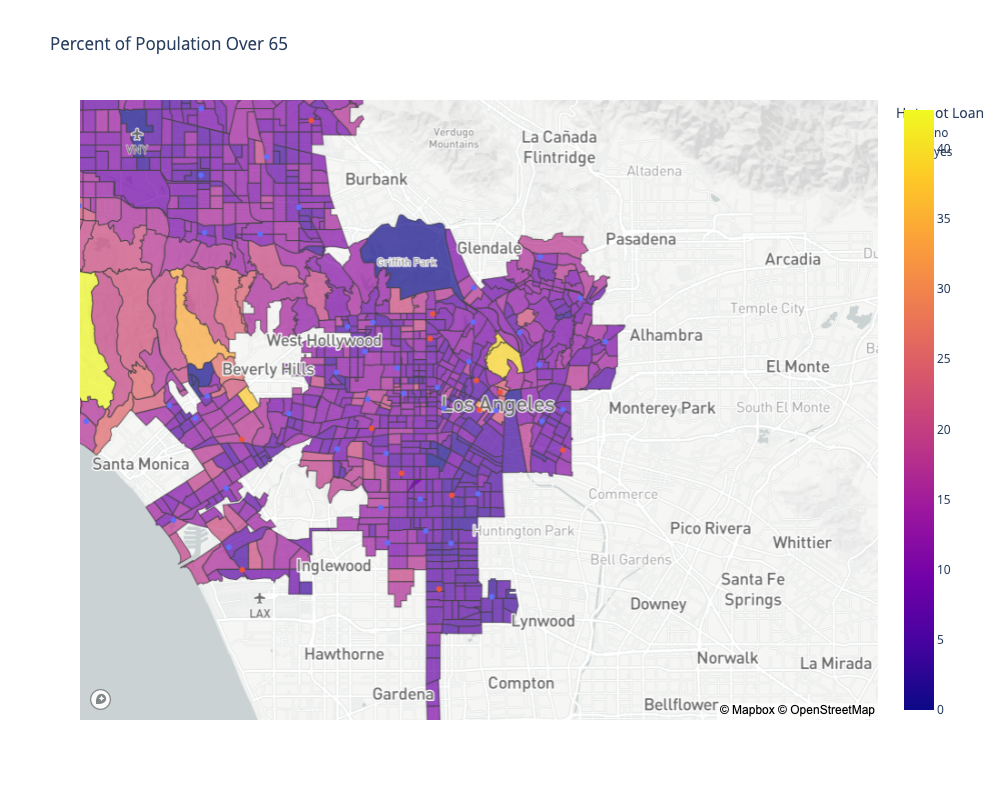

In [148]:
#Create map above but with census_age data 
fig = px.scatter_mapbox(lib_gdf, lat="lat", lon='lon', color = "Hotspot Loan",
                    # mapbox_style=mapboxstyle,
                     width = 1000,
                     height = 800,
                     zoom=10, 
                     center = {"lat": 34.0504, "lon": -118.2555},
                     hover_name='Branch Name', 
                     hover_data=['Address', 
                                 'CityZip', 
                                 'Email', 
                                 'Phone Number'], 
                                 #'lat':False, Want to remove lat & lon because it is irrelevant info for most people
                                 #'lon':False],
                     title='Percent of Population Over 65')

fig_px = px.choropleth_mapbox(census_age, 
                     geojson=census_age.geometry, 
                     locations= census_age.index, 
                     color = census_age['Percent over 65'],
                     #mapbox_style=mapboxstyle,
                     width = 1000,
                     height = 800,
                     #zoom=10, 
                     center = {"lat": 34.0504, "lon": -118.2555},
                     color_continuous_scale=["purple","#FB1E8F"],
                     opacity=0.7,
                     )
fig.add_trace(
    fig_px.data[0]
)
fig.show()

#Currently in markdown to keep the file size smaller and loads more quickly

#Create map above but with census_fb data 

fig = px.scatter_mapbox(census_fb, 
                     #geojson=census_fb.geometry, 
                     #locations= census_fb.index, 
                     color = census_fb['% Total Population: Foreign Born'],
                     size = 'Population Density (Per Sq. Mile)',
                     #mapbox_style=mapboxstyle,
                     width = 1000,
                     height = 800,
                     zoom=9, 
                     center = {"lat": 34.0504, "lon": -118.2555},
                     #color_continuous_scale=["purple","#FB1E8F"],
                     color_continuous_scale=px.colors.cyclical.IceFire,
                     #opacity=0.7,
                     title='Percent of Census Tract Foreign Born')
                    

fig_px = px.scatter_mapbox(lib_gdf, lat="lat", lon='lon', color = "Hotspot Loan",
                    # mapbox_style=mapboxstyle,
                     width = 1000,
                     height = 800,
                     zoom=9, 
                     #center = {"lat": 34.0504, "lon": -118.2555},
                     hover_name='Branch Name', 
                     hover_data=['Address', 
                                 'CityZip', 
                                 'Email', 
                                 'Phone Number'])
                     

fig.add_trace(fig_px.data[0])
fig.show()
                           

#Currently in markdown to keep the file size smaller and loads more quickly

#Create map above but with census_inc data 
fig = px.scatter_mapbox(lib_gdf, lat="lat", lon='lon', color = "Hotspot Loan",
                    # mapbox_style=mapboxstyle,
                     width = 1000,
                     height = 800,
                     zoom=9, 
                     center = {"lat": 34.0504, "lon": -118.2555},
                     hover_name='Branch Name', 
                     hover_data=['Address', 
                                 'CityZip', 
                                 'Email', 
                                 'Phone Number'], 
                                 #'lat':False, Want to remove lat & lon because it is irrelevant info for most people
                                 #'lon':False],
                     title='Percent of Census Tract Foreign Born')

fig_px = px.choropleth_mapbox(census_inc, 
                     geojson=census_inc.geometry, 
                     locations= census_inc.index, 
                     color = census_inc['Percent less than $30k'],
                     #mapbox_style=mapboxstyle,
                     width = 1000,
                     height = 800,
                     zoom=9, 
                     center = {"lat": 34.0504, "lon": -118.2555},
                     color_continuous_scale=["purple","#FB1E8F"],
                     opacity=0.7,
                     )
fig.add_trace(
    fig_px.data[0]
)
fig.show()

## Spatial Analysis

In [149]:
#I will begin by creating a spatial autocorrelation of broadband access

In [150]:
#calculate spatial weight
wq =  lps.weights.KNN.from_dataframe(hh,k=8)

#Row-standardization
wq.transform = 'r'

In [151]:
hh

,geoid,name,Total,Percent with an internet subscription,Percent with a cellular data plan with no other type of Internet,Percent with no internet access,geometry
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,77.650794,6.158730,16.317460,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",1312.0,83.460366,8.612805,9.679878,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",2297.0,73.443622,4.919460,23.421855,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",1357.0,74.944731,10.464259,20.707443,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",1445.0,82.006920,4.844291,11.141869,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."
...,...,...,...,...,...,...,...
994,14000US06037980019,"Census Tract 9800.19, Los Angeles, CA",65.0,100.000000,0.000000,0.000000,"MULTIPOLYGON (((-118.59919 34.07436, -118.5991..."
996,14000US06037980021,"Census Tract 9800.21, Los Angeles, CA",8.0,100.000000,0.000000,0.000000,"MULTIPOLYGON (((-118.40183 34.26509, -118.4017..."
999,14000US06037980024,"Census Tract 9800.24, Los Angeles, CA",75.0,94.666667,0.000000,5.333333,"MULTIPOLYGON (((-118.51849 34.18389, -118.5184..."
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",4.0,100.000000,0.000000,0.000000,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."


In [152]:
#create a new column for the spatial lag
hh['no access_lag'] = lps.weights.lag_spatial(wq, hh['Percent with no internet access'])

In [153]:
hh.sample(10)

,geoid,name,Total,Percent with an internet subscription,Percent with a cellular data plan with no other type of Internet,Percent with no internet access,geometry,no access_lag
779,14000US06037238100,"Census Tract 2381, Los Angeles, CA",1823.0,76.851344,16.785518,17.334065,"MULTIPOLYGON (((-118.31776 33.96180, -118.3177...",23.727938
740,14000US06037232300,"Census Tract 2323, Los Angeles, CA",1143.0,63.342082,17.585302,33.158355,"MULTIPOLYGON (((-118.30456 33.99598, -118.3045...",24.496259
194,14000US06037124105,"Census Tract 1241.05, Los Angeles, CA",929.0,65.231432,7.319699,31.108719,"MULTIPOLYGON (((-118.38778 34.18304, -118.3855...",17.820299
823,14000US06037243100,"Census Tract 2431, Los Angeles, CA",1530.0,64.967320,18.039216,21.045752,"MULTIPOLYGON (((-118.23904 33.93027, -118.2390...",28.641412
650,14000US06037218220,"Census Tract 2182.20, Los Angeles, CA",1461.0,78.302533,9.308693,16.153320,"MULTIPOLYGON (((-118.34079 34.04576, -118.3404...",16.711696
247,14000US06037128910,"Census Tract 1289.10, Los Angeles, CA",1954.0,95.189355,7.676561,4.810645,"MULTIPOLYGON (((-118.46950 34.16296, -118.4694...",6.252315
228,14000US06037127803,"Census Tract 1278.03, Los Angeles, CA",1670.0,76.347305,13.413174,17.425150,"MULTIPOLYGON (((-118.45746 34.20107, -118.4536...",11.694647
524,14000US06037204810,"Census Tract 2048.10, Los Angeles, CA",1245.0,74.216867,7.710843,20.642570,"MULTIPOLYGON (((-118.20956 34.02717, -118.2095...",25.879073
471,14000US06037195802,"Census Tract 1958.02, Los Angeles, CA",938.0,89.978678,33.049041,9.488273,"MULTIPOLYGON (((-118.28441 34.07773, -118.2840...",11.205183
945,14000US06037293202,"Census Tract 2932.02, Los Angeles, CA",1782.0,81.930415,16.273850,14.758698,"MULTIPOLYGON (((-118.30902 33.82563, -118.3089...",14.392678


In [154]:
#calculate the difference between access and lag
hh['no access_diff'] = hh['Percent with no internet access'] - hh['no access_lag']

In [155]:
hh.sort_values(by='no access_diff')

,geoid,name,Total,Percent with an internet subscription,Percent with a cellular data plan with no other type of Internet,Percent with no internet access,geometry,no access_lag,no access_diff
532,14000US06037206031,"Census Tract 2060.31, Los Angeles, CA",2469.0,93.317132,3.928716,3.888214,"MULTIPOLYGON (((-118.23971 34.01489, -118.2397...",36.558589,-32.670375
531,14000US06037206020,"Census Tract 2060.20, Los Angeles, CA",297.0,97.306397,4.377104,2.693603,"MULTIPOLYGON (((-118.23787 34.05427, -118.2378...",25.981114,-23.287511
546,14000US06037207900,"Census Tract 2079, Los Angeles, CA",4204.0,93.910561,4.709800,4.234063,"MULTIPOLYGON (((-118.26801 34.04065, -118.2674...",26.588317,-22.354255
543,14000US06037207501,"Census Tract 2075.01, Los Angeles, CA",1395.0,97.132616,5.949821,1.290323,"MULTIPOLYGON (((-118.25566 34.05638, -118.2553...",21.710977,-20.420655
523,14000US06037204700,"Census Tract 2047, Los Angeles, CA",1267.0,78.531965,12.549329,13.575375,"MULTIPOLYGON (((-118.21928 34.02825, -118.2188...",32.462533,-18.887159
...,...,...,...,...,...,...,...,...,...
45,14000US06037106407,"Census Tract 1064.07, Los Angeles, CA",913.0,69.112815,11.391019,29.244250,"MULTIPOLYGON (((-118.44017 34.31027, -118.4396...",10.213078,19.031172
538,14000US06037207102,"Census Tract 2071.02, Los Angeles, CA",1329.0,62.452972,6.922498,36.945071,"MULTIPOLYGON (((-118.24303 34.05735, -118.2429...",16.407947,20.537124
534,14000US06037206050,"Census Tract 2060.50, Los Angeles, CA",805.0,47.950311,10.310559,48.322981,"MULTIPOLYGON (((-118.22839 34.04156, -118.2281...",27.124138,21.198843
544,14000US06037207502,"Census Tract 2075.02, Los Angeles, CA",2196.0,57.695811,5.737705,39.890710,"MULTIPOLYGON (((-118.25855 34.05308, -118.2583...",16.571564,23.319147


In [156]:
#tract with highest negative difference
hh_donut = hh.sort_values(by='no access_diff').head(1)
hh_donut

,geoid,name,Total,Percent with an internet subscription,Percent with a cellular data plan with no other type of Internet,Percent with no internet access,geometry,no access_lag,no access_diff
532,14000US06037206031,"Census Tract 2060.31, Los Angeles, CA",2469.0,93.317132,3.928716,3.888214,"MULTIPOLYGON (((-118.23971 34.01489, -118.2397...",36.558589,-32.670375


In [157]:
#tract with highest positive difference
hh_diamond = hh.sort_values(by='no access_diff').tail(1)
hh_diamond

,geoid,name,Total,Percent with an internet subscription,Percent with a cellular data plan with no other type of Internet,Percent with no internet access,geometry,no access_lag,no access_diff
536,14000US06037206300,"Census Tract 2063, Los Angeles, CA",2433.0,31.113851,7.768187,62.515413,"MULTIPOLYGON (((-118.25041 34.04326, -118.2490...",21.605121,40.910292


/opt/conda/lib/python3.9/site-packages/contextily/tile.py:581: UserWarning:

The inferred zoom level of 27 is not valid for the current tile provider (valid zooms: 0 - 20).



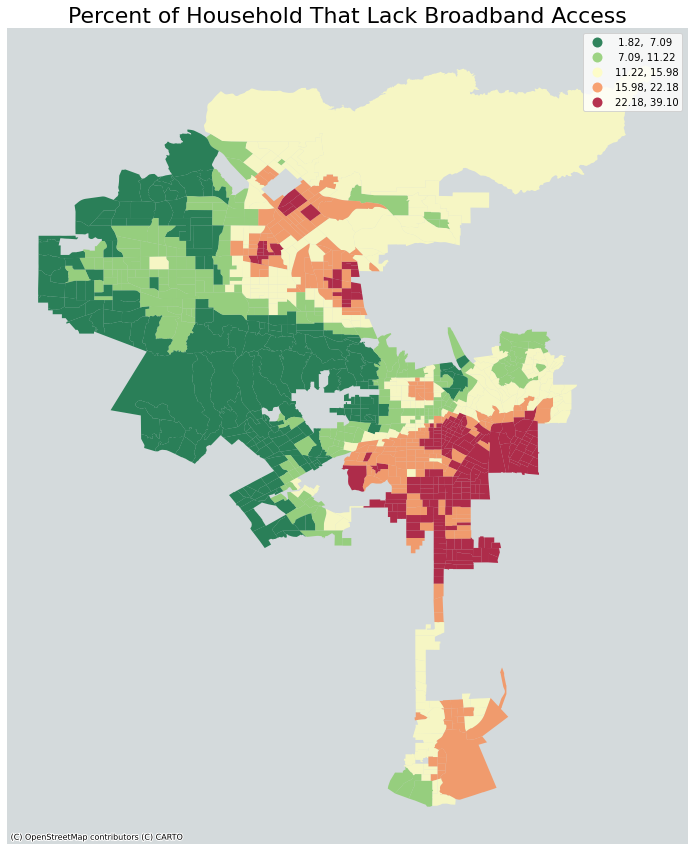

In [158]:
# use subplots that make it easier to create multiple layered maps
fig, ax = plt.subplots(figsize=(15, 15))

# spatial lag choropleth
hh.plot(ax=ax,
         figsize=(15,15),
         column='no access_lag',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles')

ax.axis('off')
ax.set_title('Percent of Household That Lack Broadband Access',fontsize=22)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [159]:
#To begin Moran's plot, I furst need string together the nanes of the hh columns
hh.columns

Index(['geoid', 'name', 'Total', 'Percent with an internet subscription',
       'Percent with a cellular data plan with no other type of Internet',
       'Percent with no internet access', 'geometry', 'no access_lag',
       'no access_diff'],
      dtype='object')

In [160]:
hh.columns = ['geoid',
              'name',
              'total',
              'percent_with_subscription',
              'percent_only_cell',
              'percent_no_access',
              'geometry',
              'no_access_lag',
              'no_access_diff']
hh

,geoid,name,total,percent_with_subscription,percent_only_cell,percent_no_access,geometry,no_access_lag,no_access_diff
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",1575.0,77.650794,6.158730,16.317460,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",10.588444,5.729017
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",1312.0,83.460366,8.612805,9.679878,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",11.637572,-1.957693
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",2297.0,73.443622,4.919460,23.421855,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",10.563585,12.858270
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",1357.0,74.944731,10.464259,20.707443,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",10.902887,9.804556
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",1445.0,82.006920,4.844291,11.141869,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",12.098583,-0.956715
...,...,...,...,...,...,...,...,...,...
994,14000US06037980019,"Census Tract 9800.19, Los Angeles, CA",65.0,100.000000,0.000000,0.000000,"MULTIPOLYGON (((-118.59919 34.07436, -118.5991...",3.880614,-3.880614
996,14000US06037980021,"Census Tract 9800.21, Los Angeles, CA",8.0,100.000000,0.000000,0.000000,"MULTIPOLYGON (((-118.40183 34.26509, -118.4017...",16.380340,-16.380340
999,14000US06037980024,"Census Tract 9800.24, Los Angeles, CA",75.0,94.666667,0.000000,5.333333,"MULTIPOLYGON (((-118.51849 34.18389, -118.5184...",9.325247,-3.991913
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",4.0,100.000000,0.000000,0.000000,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517...",12.847556,-12.847556


In [161]:
y = hh.percent_no_access
moran = Moran(y, wq)
moran.I

0.6251290229137995

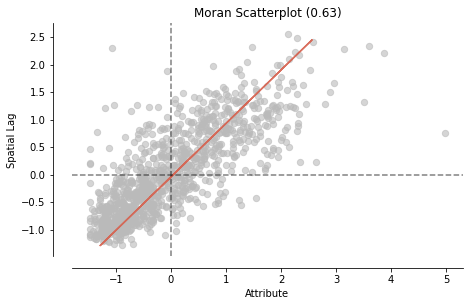

In [162]:
fig, ax = moran_scatterplot(moran, aspect_equal=True)
plt.show()

(<Figure size 504x504 with 1 Axes>,
 <AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: 0.63', ylabel='Density'>)

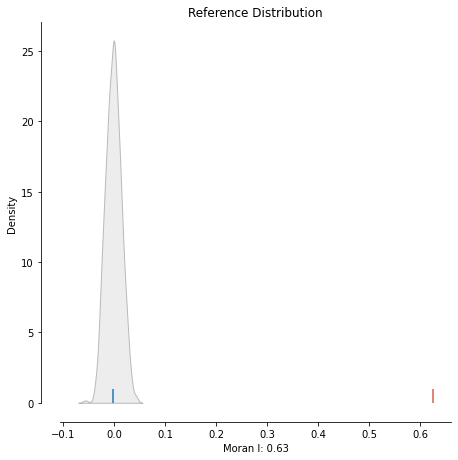

In [163]:
plot_moran_simulation(moran,aspect_equal=False)

In [164]:
# calculate local moran values
lisa = esda.moran.Moran_Local(y, wq)

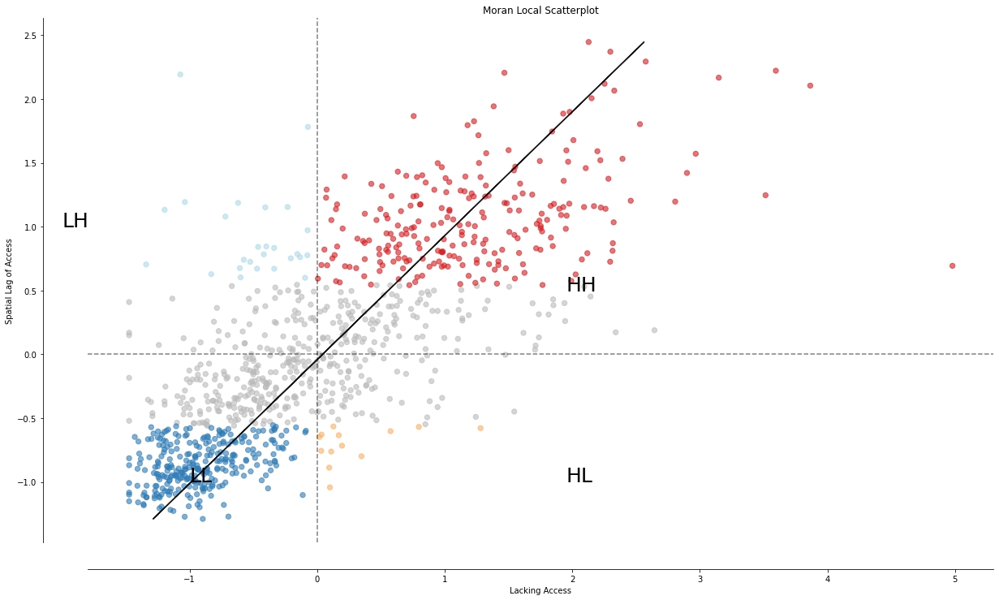

In [165]:
# Plot
fig,ax = plt.subplots(figsize=(20,15))

moran_scatterplot(lisa, ax=ax, p=0.05)
ax.set_xlabel("Lacking Access")
ax.set_ylabel('Spatial Lag of Access')

# add some labels
plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

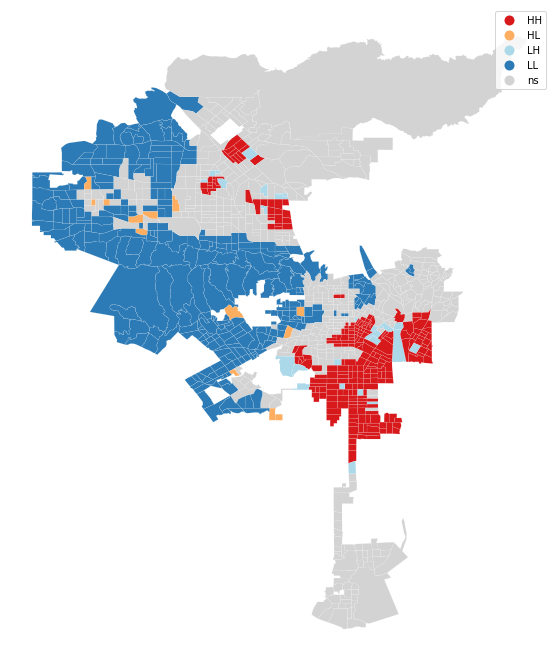

In [166]:
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa, hh, p=0.05, ax=ax)
plt.show()

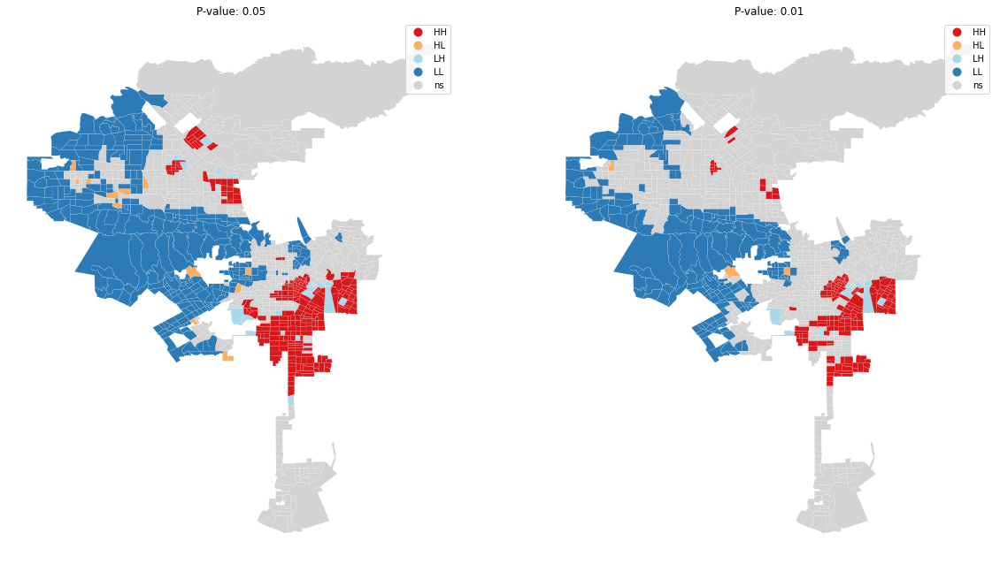

In [167]:
# create the 1x2 subplots
fig, ax = plt.subplots(1, 2, figsize=(20, 12))

# regular count map on the left
lisa_cluster(lisa, hh, p=0.05, ax=ax[0])

ax[0].axis("off")
ax[0].set_title("P-value: 0.05")

# spatial lag map on the right
lisa_cluster(lisa, hh, p=0.01, ax=ax[1])
ax[1].axis("off")
ax[1].set_title("P-value: 0.01")

plt.show()

### Open Street Maps

In [168]:
#I will do a trial of the isochrom map from the LA Central library Branch
#first, configure that place, network type, trip times and trvael speed for a walking map
center_point = (34.0504,-118.2555)
network_type = 'walk'
trip_times = [5, 15, 30]
meters_per_minute = 75

In [169]:
%%time
G = ox.graph_from_point(center_point, network_type=network_type)

CPU times: user 2.92 s, sys: 71.8 ms, total: 2.99 s
Wall time: 3.16 s


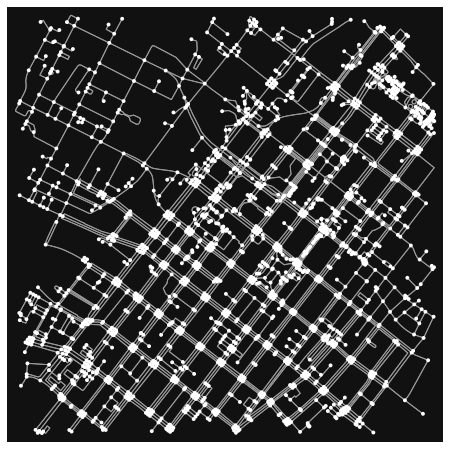

In [170]:
fig, ax = ox.plot_graph(G)

In [171]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [172]:
#convert nodes and edges to geodataframes
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [173]:
gdf_nodes.sample(10)

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
2889730940,4.035930e+06,-1.316330e+07,NaN,3,-118.247979,34.053069,POINT (-13163304.798 4035930.111)
3663693325,4.035432e+06,-1.316423e+07,NaN,4,-118.256260,34.049363,POINT (-13164226.602 4035432.172)
2802660755,4.035177e+06,-1.316427e+07,NaN,4,-118.256666,34.047467,POINT (-13164271.842 4035177.494)
71987159,4.036720e+06,-1.316324e+07,traffic_signals,3,-118.247410,34.058947,POINT (-13163241.469 4036719.930)
7396420742,4.035421e+06,-1.316298e+07,NaN,1,-118.245074,34.049281,POINT (-13162981.382 4035421.168)
3663224279,4.034848e+06,-1.316470e+07,crossing,4,-118.260469,34.045012,POINT (-13164695.157 4034847.573)
3663691132,4.034538e+06,-1.316388e+07,crossing,4,-118.253130,34.042709,POINT (-13163878.272 4034538.204)
8385752738,4.035410e+06,-1.316339e+07,NaN,4,-118.248758,34.049199,POINT (-13163391.583 4035410.164)
122888807,4.035634e+06,-1.316470e+07,traffic_signals,3,-118.260525,34.050863,POINT (-13164701.480 4035633.717)


<AxesSubplot:>

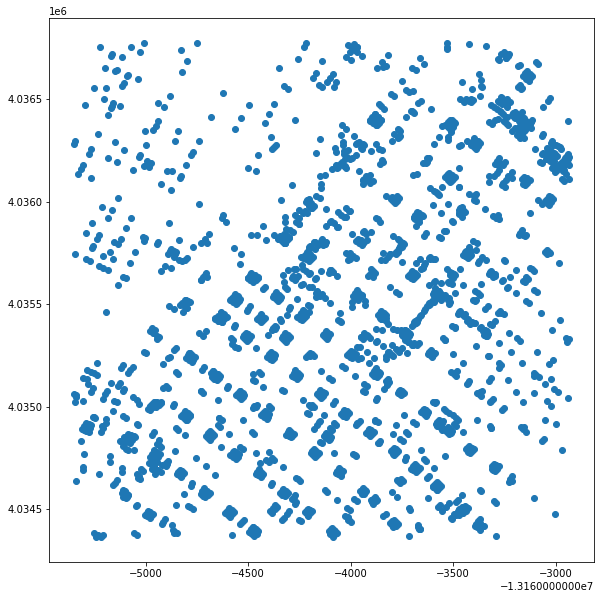

In [174]:
gdf_nodes.plot (figsize=(10,10))

In [175]:
stats = ox.basic_stats(G, circuity_dist='euclidean')
stats

/opt/conda/lib/python3.9/site-packages/osmnx/stats.py:317: UserWarning:

The `circuity_dist` argument has been deprecated and will be removed in a future release.



{'n': 2076,
 'm': 6562,
 'k_avg': 6.321772639691715,
 'edge_length_total': 277308.9640000002,
 'edge_length_avg': 42.25982383419692,
 'streets_per_node_avg': 3.226878612716763,
 'streets_per_node_counts': {0: 0, 1: 277, 2: 0, 3: 790, 4: 994, 5: 14, 6: 1},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.13342967244701348,
  2: 0.0,
  3: 0.3805394990366089,
  4: 0.47880539499036606,
  5: 0.00674373795761079,
  6: 0.0004816955684007707},
 'intersection_count': 1799,
 'street_length_total': 138654.48199999979,
 'street_segment_count': 3281,
 'street_length_avg': 42.25982383419682,
 'circuity_avg': 0.8638343149246476,
 'self_loop_proportion': 0.001828710758914965}

In [176]:
#get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13165349.225457974
4034364.472519913
-13162935.184376476
4036774.739681407


In [177]:
#calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13164142.204917226
4035569.60610066


In [178]:
#find the nearest node
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 4632585779


In [179]:
gdf_nodes.loc[[center_node]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
4632585779,4.035566e+06,-1.316416e+07,NaN,1,-118.255681,34.050356,POINT (-13164162.181 4035565.586)


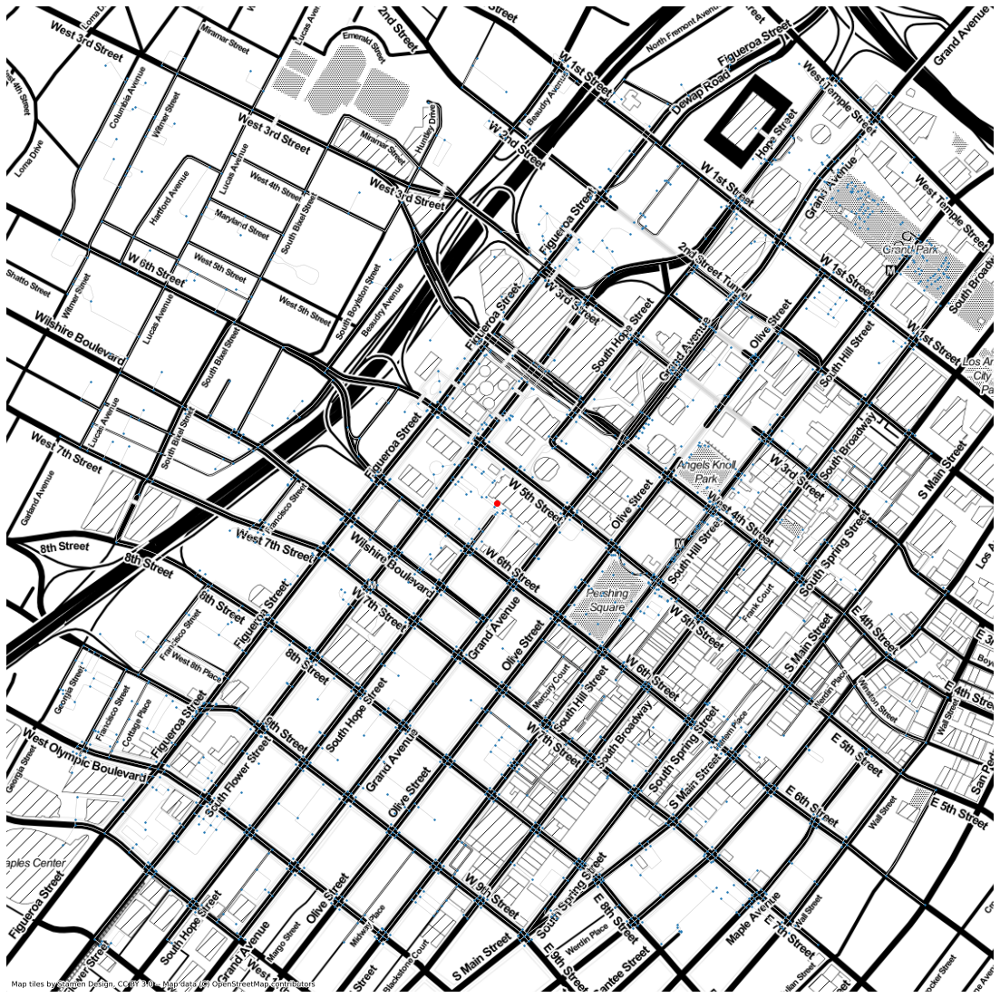

In [180]:
#Begin mapping the network layers
fig, ax = plt.subplots (figsize=(20,20))

gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro',
               zorder=10)

gdf_nodes.plot(ax=ax,
               markersize=2,
               zorder=20)

gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color = 'r',
                                  zorder=30)

ax.axis('off')

ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner)

In [181]:
#start calculating the travel cost to build the isochrome
gdf_edges[['osmid','name','highway','length']].sample(5)

,,,osmid,name,highway,length
u,v,key,,,,
3396354502,1376475640,0,123429024,NaN,footway,6.638
2164323101,6474121665,0,206425363,NaN,service,46.420
250781442,337203101,0,185948941,Figueroa Street,primary,36.590
3663669097,2820039359,0,285297491,NaN,footway,10.227
3664674397,2871010065,0,900897618,NaN,footway,13.246


In [182]:
gdf_edges['walk_time'] = gdf_edges['length']/meters_per_minute

In [183]:
gdf_edges[['osmid','name','highway','length','walk_time']].sample(10)

,,,osmid,name,highway,length,walk_time
u,v,key,,,,,
72027642,3664674402,0,608501618,Olive Street,primary,9.023,0.120307
122641711,122641705,0,237022768,West 5th Street,secondary,112.161,1.495480
3663669118,7831153403,0,607576340,South Flower Street,secondary,30.388,0.405173
7331115984,7331115983,0,784721296,NaN,service,30.838,0.411173
3404799218,4879577296,0,285316522,NaN,footway,67.523,0.900307
5344542574,1734858161,0,13428970,Saint Paul Place,residential,12.973,0.172973
4467499785,8873833275,0,381459560,West 2nd Street,secondary,13.912,0.185493
3355287157,2889674334,0,285293525,NaN,footway,105.389,1.405187
2164323092,6471427786,0,437912349,South Spring Street,primary,40.362,0.538160


In [184]:
#begin to visualize the isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[5, 15, 30]
['#0d0887', '#cc4778', '#f0f921']


In [185]:
trip_times.sort(reverse=True)
print(trip_times)
print(iso_colors)

[30, 15, 5]
['#0d0887', '#cc4778', '#f0f921']


In [186]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(30, '#0d0887'), (15, '#cc4778'), (5, '#f0f921')]

In [187]:
#Let's loop!
for time,color in list(time_color):
    print('The color for '+str(time)+' minutes is ' + color)

The color for 30 minutes is #0d0887
The color for 15 minutes is #cc4778
The color for 5 minutes is #f0f921


In [188]:
#loop through each trip time and associated color
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, center_node, radius=time, distance='time')

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 1838 nodes within 30 minutes 
There are 385 nodes within 15 minutes 
There are 22 nodes within 5 minutes 


In [189]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

<AxesSubplot:>

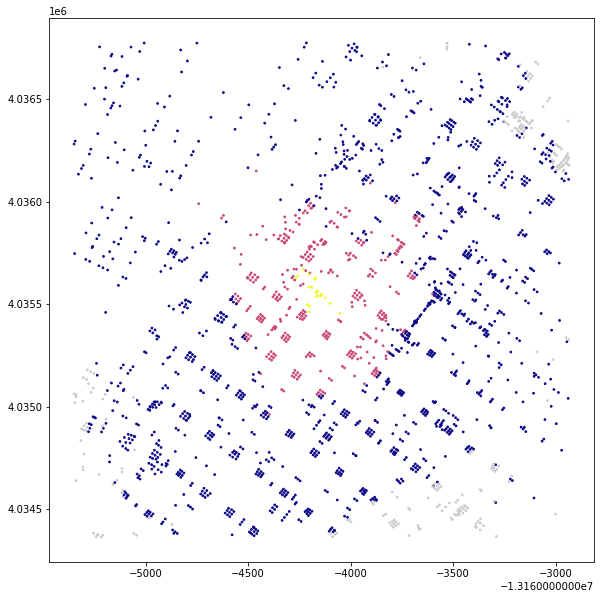

In [190]:
#mapping!
gdf_nodes.plot(figsize=(10,10),
               color=gdf_nodes['color'],
               markersize=3)

In [191]:
#Now I will being creating polygons for each time zone
gdf_5 = gdf_nodes[gdf_nodes['time']=='5 mins']

In [192]:
# dissolve the nodes by time
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
15 mins,"MULTIPOINT (-13164741.822 4035990.613, -131646...",4.035526e+06,-1.316456e+07,traffic_signals,4,-118.259253,34.050061,#cc4778
30 mins,"MULTIPOINT (-13165349.225 4036281.251, -131653...",4.036374e+06,-1.316351e+07,traffic_signals,4,-118.249821,34.056371,#0d0887
5 mins,"MULTIPOINT (-13164267.356 4035626.193, -131642...",4.035463e+06,-1.316420e+07,None,3,-118.256057,34.049596,#f0f921


In [193]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,15 mins,"POLYGON ((-13164396.509 4034962.440, -13164741..."
1,30 mins,"POLYGON ((-13164470.970 4034371.458, -13164862..."
2,5 mins,"POLYGON ((-13164052.487 4035456.369, -13164204..."


In [194]:
isochrones.columns=['time','geometry']

<AxesSubplot:>

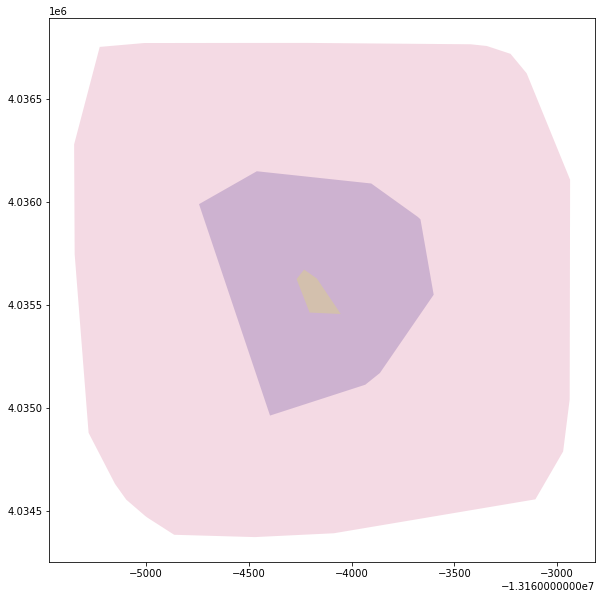

In [195]:
isochrones.plot(figsize=(10,10),alpha=0.2,cmap='plasma')

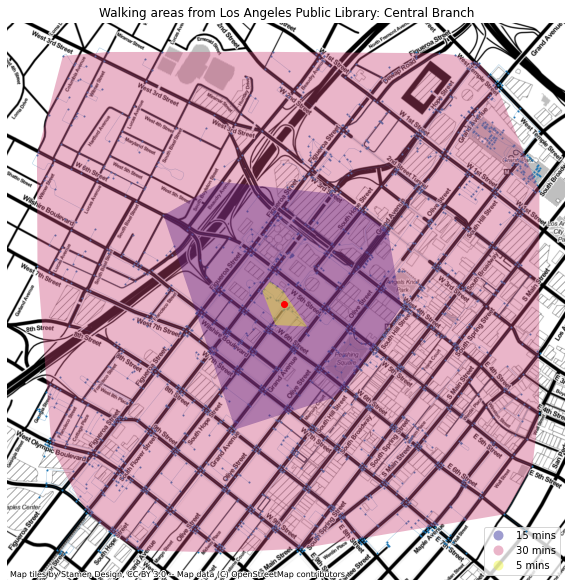

In [196]:
fig, ax = plt.subplots(figsize=(10,15))

isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')


ax.set_title('Walking areas from Los Angeles Public Library: Central Branch')

ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner)

In [197]:
#Now I will make a isochrone map for biking to the library
center_point = (34.0504,-118.2555)
network_type = 'bike'
trip_times = [15, 30]
meters_per_minute = 200

In [198]:
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 4632585779


In [199]:
gdf_edges['bike_time'] = gdf_edges['length']/meters_per_minute

In [200]:
gdf_edges[['osmid','name','highway','length','walk_time']].sample(10)

,,,osmid,name,highway,length,walk_time
u,v,key,,,,,
8385752741,123396141,0,382238064,South Broadway,secondary,72.932,0.972427
26666275,3665206535,0,161687300,Olive Street,primary,10.245,0.136600
18166169,3151976057,0,382210034,West 1st Street,primary,11.781,0.157080
2820039386,3663692511,0,277498503,NaN,footway,12.491,0.166547
3596007789,8421237217,0,"[438255393, 399270702]",East 7th Street,primary,49.047,0.653960
1738802894,69091973,0,186070722,East 5th Street,primary,57.688,0.769173
5742723396,2871078047,0,283208608,NaN,footway,89.805,1.197400
3144543759,3663685696,0,309136425,NaN,service,11.143,0.148573
123292029,3663224277,0,381243038,South Hope Street,secondary,9.032,0.120427


In [201]:
#begin to visualize the isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='cool', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[15, 30]
['#00ffff', '#ff00ff']


In [202]:
trip_times.sort(reverse=True)
print(trip_times)
print(iso_colors)

[30, 15]
['#00ffff', '#ff00ff']


In [203]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(30, '#00ffff'), (15, '#ff00ff')]

In [204]:
#loop through each trip time and associated color
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, center_node, radius=time, distance='time')

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 1838 nodes within 30 minutes 
There are 385 nodes within 15 minutes 


In [205]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

<AxesSubplot:>

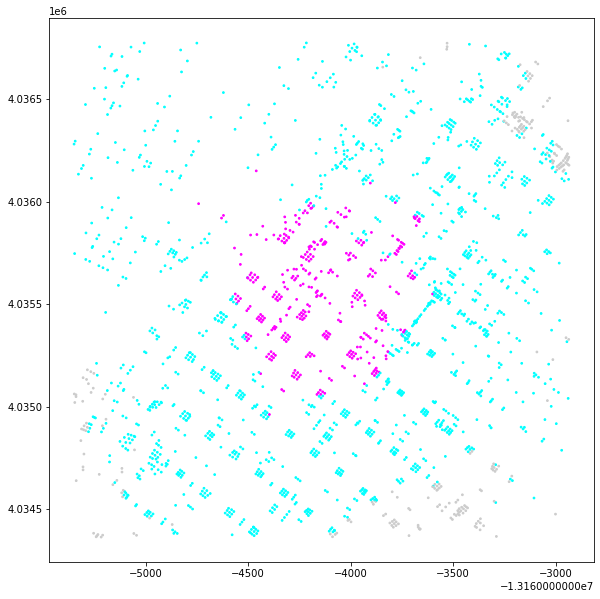

In [206]:
#mapping!
gdf_nodes.plot(figsize=(10,10),
               color=gdf_nodes['color'],
               markersize=3)

In [207]:
#Now I will being creating polygons for each time zone
gdf_15 = gdf_nodes[gdf_nodes['time']=='15 mins']

In [208]:
# dissolve the nodes by time
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
15 mins,"MULTIPOINT (-13164741.822 4035990.613, -131646...",4.035526e+06,-1.316456e+07,traffic_signals,4,-118.259253,34.050061,#ff00ff
30 mins,"MULTIPOINT (-13165349.225 4036281.251, -131653...",4.036374e+06,-1.316351e+07,traffic_signals,4,-118.249821,34.056371,#00ffff


In [209]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,15 mins,"POLYGON ((-13164396.509 4034962.440, -13164741..."
1,30 mins,"POLYGON ((-13164470.970 4034371.458, -13164862..."


In [210]:
isochrones.columns=['time','geometry']

<AxesSubplot:>

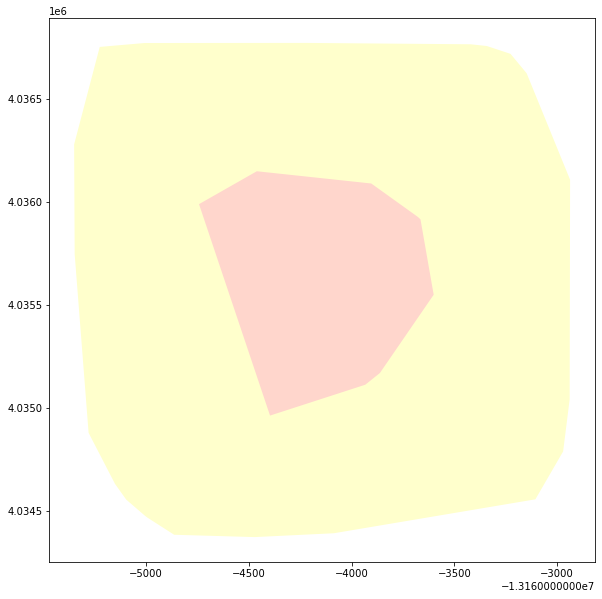

In [211]:
isochrones.plot(figsize=(10,10),alpha=0.2,cmap='spring')

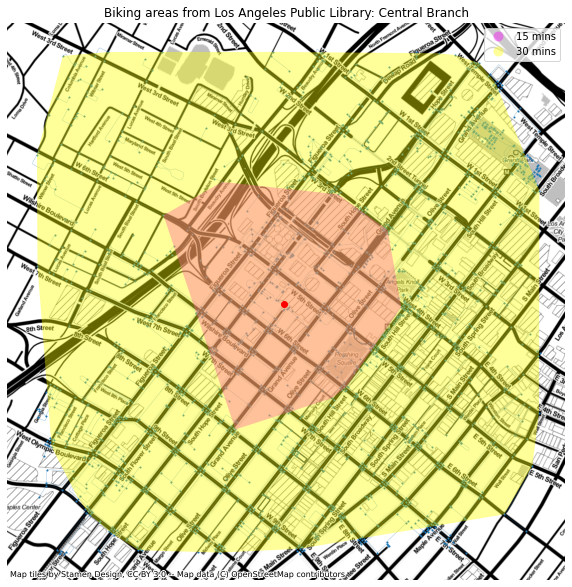

In [212]:
ig, ax = plt.subplots(figsize=(10,15))

isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='spring', 
                legend=True,
                zorder=20)

gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')


ax.set_title('Biking areas from Los Angeles Public Library: Central Branch')

ctx.add_basemap(ax, source=ctx.providers.Stamen.Toner)

Michael Criste: Development & Analysis